In [1]:
import numpy as np
import torch
import torch.nn.functional as F
import matplotlib.pyplot as plt
from wave_prop_module import Wave2d
from torch import optim
from unet import UNet

In [26]:
# loss function

def grad_optr(image):

    dx = image.squeeze() - F.pad(image.squeeze(), (0, 1, 0, 0))[:, 1:]
    dy = image.squeeze() - F.pad(image.squeeze(), (0, 0, 0, 1))[1:, :]

    dx[:, -1] = 0
    dy[-1, :] = 0

    return dx, dy

def wrap(vector):
    return torch.remainder(vector + torch.pi, 2*torch.pi)

def loss_fn(predict, target):
    
    del_pred_x, del_pred_y = grad_optr(predict)
    del_tar_x, del_tar_y = grad_optr(target)

    dx_dy_pred = torch.concat([wrap(del_pred_x).ravel().unsqueeze(dim=1), wrap(del_pred_y).ravel().unsqueeze(dim=1)], dim=1)
    dx_dy_tar_wrap = torch.concat([wrap(del_tar_x).ravel().unsqueeze(dim=1), wrap(del_tar_y).ravel().unsqueeze(dim=1)], dim=1)

    norm = torch.linalg.norm(dx_dy_pred- dx_dy_tar_wrap, dim=1)
    loss = torch.sum(norm)


    return loss

def total_variation_loss(img, weight):
     h_img, w_img = img.size()
     tv_h = torch.pow(img[1:,:]-img[:-1,:], 2).sum()
     tv_w = torch.pow(img[:,1:]-img[:,:-1], 2).sum()
     return weight*(tv_h+tv_w)/(h_img*w_img)

def l2_loss(img, target):
    return torch.norm(img.ravel() - target.ravel())/target.ravel().size()[0]

In [27]:
def propagation(numPx, sizePx=[6*1e-6, 6*1e-6], wl=550*1e-9):

    sizeSensorX = numPx[0]*sizePx[0] # sensor size along x-axis
    sizeSensorY = numPx[1]*sizePx[1] # sensor size along y-axis

    # Sampling plane 2x for linearization
    Sx = sizeSensorX
    Sy = sizeSensorY

    # max freq to prevent aliasing by the transfer function
    delU = 1/Sx
    delV = 1/Sy

    freqRows = torch.linspace(-1/(2*sizePx[0]), 1/(2*sizePx[0]), round(1/(sizePx[0]*delU))) ## -maxFreq/2, +maxFreq/2
    freqCols = torch.linspace(-1/(2*sizePx[1]), 1/(2*sizePx[1]), round(1/(sizePx[1]*delV)))

    u, v = torch.meshgrid(freqRows, freqCols)
    k = wl**(-2) - u**2 - v**2

    return torch.sqrt(k)

In [160]:
model = UNet(num_input_channels=1, num_output_channels=1) # postprocessor

# complete model
device = torch.device('cuda:0')

# incident wave
X, Y = np.meshgrid(np.linspace(-1, 1, 1024), np.linspace(-1, 1, 1360))

A = torch.tensor([X.T.ravel(), Y.T.ravel(), X.T.ravel()*Y.T.ravel(), X.T.ravel()*X.T.ravel(), Y.T.ravel()*Y.T.ravel(), np.ones_like(X.T.ravel()), 
              (X.T.ravel())**3, (Y.T.ravel())**3, X.T.ravel()*(Y.T.ravel())**2, Y.T.ravel()*(X.T.ravel())**2], dtype=torch.float32).T


# coeffs = torch.rand(10, 1, requires_grad=True)
# coeffs = torch.FloatTensor(10, 1).uniform_(-1, 1)
coeffs = torch.tensor([[ -13.53],
        [-113.3250],
        [ -12.7425],
        [   4.4154],
        [   6.2158],
        [ -119.261],
        [   2.3329],
        [  1.3617],
        [   1.5364],
        [  3.5796]])
coeffs.requires_grad=True

# obj_amp = torch.rand(1024, 1360, requires_grad=True)
obj_phase = torch.rand(1024, 1360, requires_grad=True)
obj_amp = torch.rand(1024, 1360, requires_grad=True)

phase_img = np.load('phase_0.npy')
abs_img = np.load('abs_0.npy')

target_phase = torch.tensor(phase_img).T
target_abs = torch.tensor(abs_img).T

cons = torch.tensor(3.2, requires_grad=True)
# dist = torch.tensor(145.003) # mm 


optimizer = optim.Adam([
    {'params': obj_phase, 'lr': 1e-1},
    {'params': obj_amp, 'lr': 1e-1},
    {'params': coeffs, 'lr': 1e-1},
    {'params': cons, 'lr': 1e-2},
    # {'params': dist, 'lr': 1e-2}
    ],
    lr=0.01, betas=(0.9, 0.999)
    )
optimizer_proc = optim.Adam([
    {'params': model.parameters(), 'lr': 2e-2}],
    lr=0.01, betas=(0.9, 0.999)
    )

wave_obj = Wave2d(
        numPx = list(obj_phase.shape), 
        sizePx = [6*1e-3, 6*1e-3], 
        wl = 550*1e-6
        )

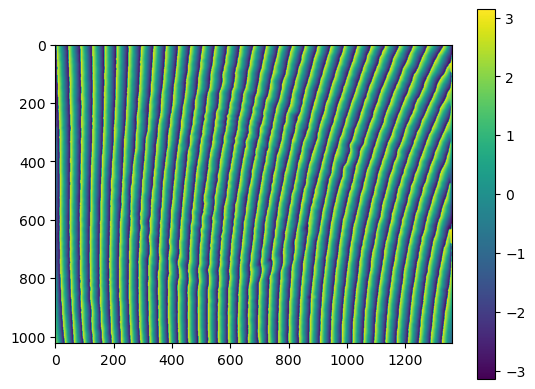

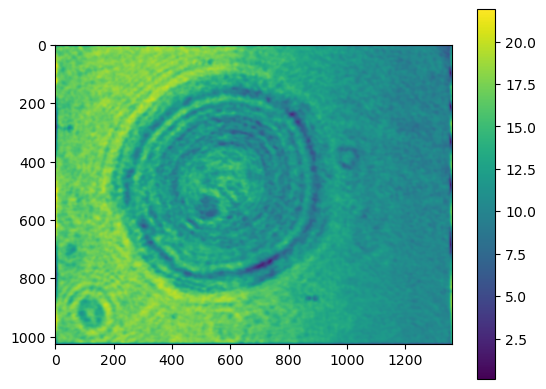

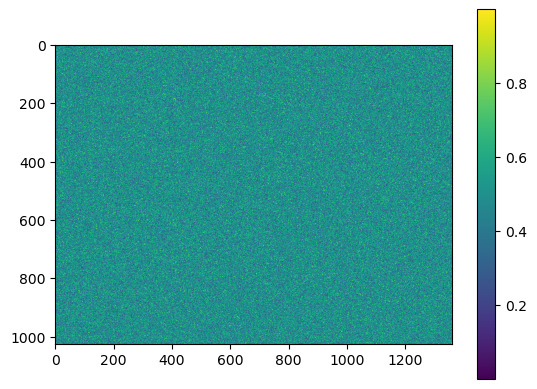

In [161]:
plt.imshow(target_phase.T)
plt.colorbar()
plt.show()

plt.imshow(target_abs.T)
plt.colorbar()
plt.show()

plt.imshow(obj_phase.detach())
plt.colorbar()
plt.show()

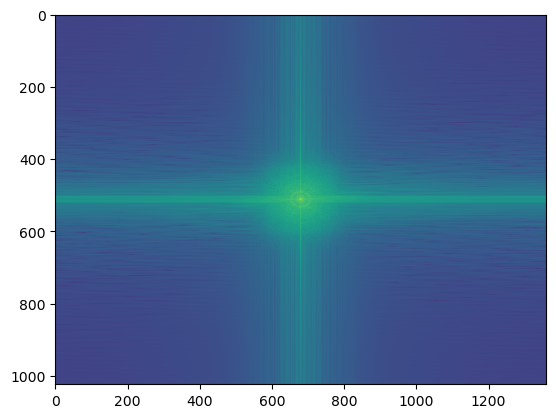

In [162]:
plt.imshow(np.fft.fftshift(np.log10(torch.abs(torch.fft.fft2(target_abs.T)))))

0 0.5977133998630235


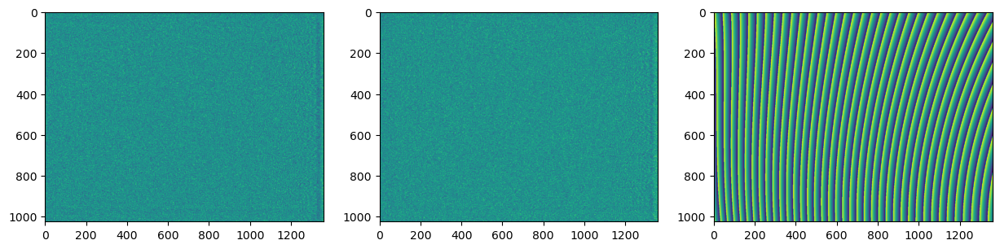

1 0.4231210408404724
2 0.3391741531970252
3 0.32130811333688436
4 0.3188289379059714
5 0.3104880520853933
6 0.29566742956345216
7 0.2786349138339711
8 0.2633543356874645
9 0.2517928678624035
10 0.24358790088907184
11 0.23709688512833038
12 0.23100286759999653
13 0.22472912881947826
14 0.21832508890331212
15 0.21218580176593213
16 0.20662738206129294
17 0.2017329698825836
18 0.1973856577916197
19 0.1933173238232464
20 0.18952486376649333
21 0.18595622564770276
22 0.18250066052895514
23 0.1792885956195921
24 0.1763309444663423
25 0.1735960602486051
26 0.171051701238708
27 0.1686507561897113
28 0.16630972753927406
29 0.16420090101100124
30 0.16220920814360484
31 0.1602743949307467
32 0.15859189574261948
33 0.15697478439049317
34 0.15543834576265586
35 0.15401030946697794
36 0.15271016345058636
37 0.15144492666096265
38 0.1502176679603198
39 0.14909742525920255
40 0.14802336292709484
41 0.1470272377442926
42 0.1460495228079321
43 0.14509878129631057
44 0.1442656450870718
45 0.1433881098189

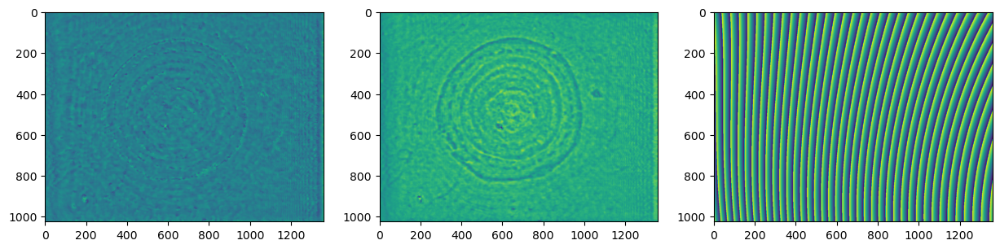

201 0.10109030438201475
202 0.10103439332878697
203 0.10087769286409382
204 0.10077444266721175
205 0.10061163755114796
206 0.10052426069949974
207 0.10038889377758775
208 0.10027150008200078
209 0.1001779379384418
210 0.10003456193067889
211 0.09995507642043205
212 0.09981864449486846
213 0.09973147363528505
214 0.09957956281470359
215 0.09947647662398651
216 0.09932517829253895
217 0.09922325921339414
218 0.09913672462921072
219 0.09902170267116478
220 0.09893209029789748
221 0.0987836057128535
222 0.09873750420475974
223 0.09859414609307264
224 0.09854160090562253
225 0.0983766890654202
226 0.09831157357235665
227 0.09816371539244871
228 0.09806307700993679
229 0.09795585733311674
230 0.09787118585861253
231 0.09778186510133369
232 0.09765964050672359
233 0.09760219093720564
234 0.09750187888087308
235 0.09738214215783636
236 0.09727262992938052
237 0.09717919416777444
238 0.09707501998797832
239 0.0969445406806791
240 0.09691738035673991
241 0.09672461470376606
242 0.09666641605229

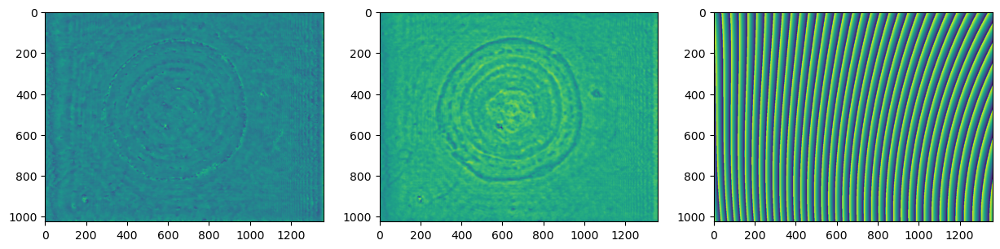

401 0.08508907137107971
402 0.0850648360260884
403 0.08498495175998538
404 0.08490659080070895
405 0.0849191047054399
406 0.08477398949750589
407 0.08476670621152488
408 0.08466085801695386
409 0.08466741627274889
410 0.08455879545753163
411 0.08456534816047746
412 0.0844524819047125
413 0.0844698464663152
414 0.0843731744884496
415 0.08433685025826146
416 0.08428020625247115
417 0.08429109946742362
418 0.08416157261614188
419 0.08422934741321828
420 0.08404857275737136
421 0.08404797430692738
422 0.08395958664757908
423 0.08396475863626358
424 0.08383752096723608
425 0.08391968800840918
426 0.08374212514789149
427 0.08382008427207584
428 0.08368121575900672
429 0.08367177632237091
430 0.08353364210347955
431 0.08357347483192615
432 0.08342751440990591
433 0.08347495357092145
434 0.08338051610464016
435 0.0833869679551744
436 0.08331851870754853
437 0.08326973574441619
438 0.0832131684672362
439 0.08310543448884598
440 0.08310562423484222
441 0.08306700669981883
442 0.0829608193190646


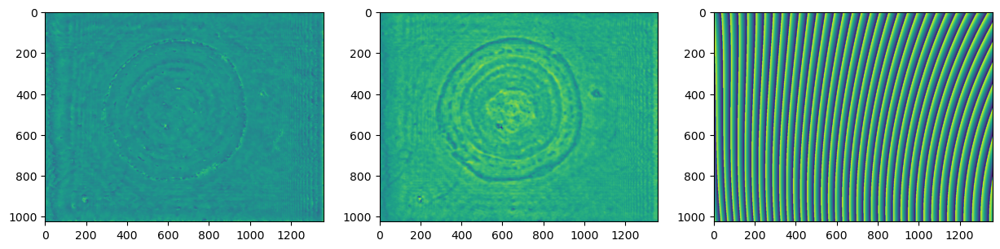

601 0.07701416726384197
602 0.07693821527034878
603 0.07691304805664324
604 0.07687551758255186
605 0.07683882588498268
606 0.07681040636780344
607 0.07681097088485424
608 0.07673526385154586
609 0.07676174661317836
610 0.07670963164076036
611 0.07668354526007172
612 0.07666666393741003
613 0.07663406614617832
614 0.07658374163095971
615 0.0765837112035994
616 0.07649119587063993
617 0.07648447751647028
618 0.07642827335456025
619 0.0764405847428631
620 0.07641059321842923
621 0.07641804248529555
622 0.07638343716196626
623 0.0763188668415144
624 0.07627364788547933
625 0.07632297433143376
626 0.0761783522574882
627 0.07623173157324581
628 0.07615658412449124
629 0.07617847883194376
630 0.0760889189641353
631 0.07609674486511175
632 0.0760248733385302
633 0.076043767474886
634 0.07598545831197415
635 0.07601905538773836
636 0.07594490172701998
637 0.07595259663523109
638 0.07593394159194268
639 0.07586995723002189
640 0.07585968675860477
641 0.07579511711493397
642 0.07577275644338202


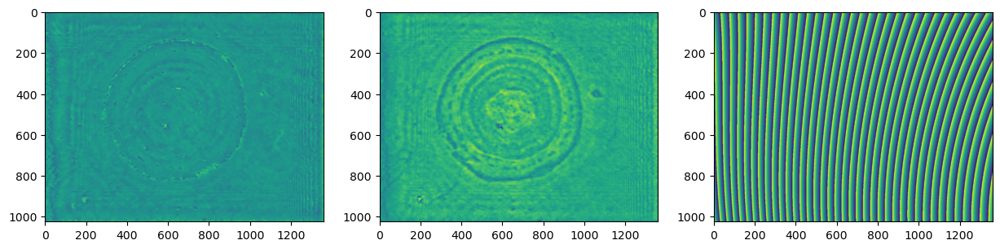

801 0.07217236484756913
802 0.0720665787005097
803 0.07219382431482953
804 0.07210124310431602
805 0.07215581295501335
806 0.0721068172529498
807 0.07207243804965488
808 0.07209039242843746
809 0.07207141109329646
810 0.07203164266497929
811 0.07200607319314663
812 0.07196487594085493
813 0.07199066753523746
814 0.07188827083531836
815 0.07197815303616106
816 0.07189229145448958
817 0.07190285685370962
818 0.0718740978475937
819 0.07187960410614024
820 0.07185626134964011
821 0.07181715280655371
822 0.07180804015518358
823 0.07177145324615675
824 0.0717493127617433
825 0.07172521217819583
826 0.07169511505226807
827 0.07171389965269329
828 0.07169112365959145
829 0.0716232632437363
830 0.0716687550856925
831 0.07156299647215306
832 0.07160617599022967
833 0.0715654870481085
834 0.07155018888306837
835 0.07154340981200846
836 0.07154099903020954
837 0.0715013341090959
838 0.07150938112737022
839 0.0714797939023104
840 0.07143158744788902
841 0.07141748977560641
842 0.07138006335630956
8

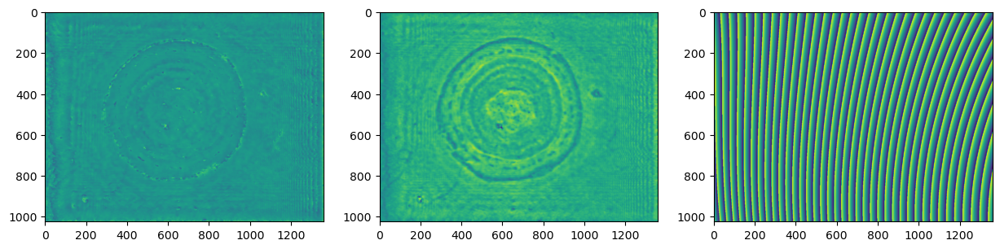

1001 0.06897978287822991
1002 0.06902500934748632
1003 0.06897071962597104
1004 0.06897536917274141
1005 0.06894070570714522
1006 0.0689391351455938
1007 0.06895186752879351
1008 0.06888410263031061
1009 0.06889828207529392
1010 0.06886928774377768
1011 0.06887282030976916
1012 0.06883943332288539
1013 0.06889846592132155
1014 0.06881295600157998
1015 0.06882237010864069
1016 0.06882532002569357
1017 0.06878568757834364
1018 0.06875937402714256
1019 0.0687657585410323
1020 0.06870636227238923
1021 0.06872676458126505
1022 0.06871076473389146
1023 0.06875185840682471
1024 0.06867727943160944
1025 0.06873970658155062
1026 0.06865092691017965
1027 0.06869068185302864
1028 0.06866144992830575
1029 0.06866559119563037
1030 0.06863796817167209
1031 0.06861070861122448
1032 0.06859120878223286
1033 0.06856275583153518
1034 0.06857208708299252
1035 0.06854101254648579
1036 0.06851825499578895
1037 0.0685534745383834
1038 0.06851993015145211
1039 0.06849281177633533
1040 0.06850303888165225
104

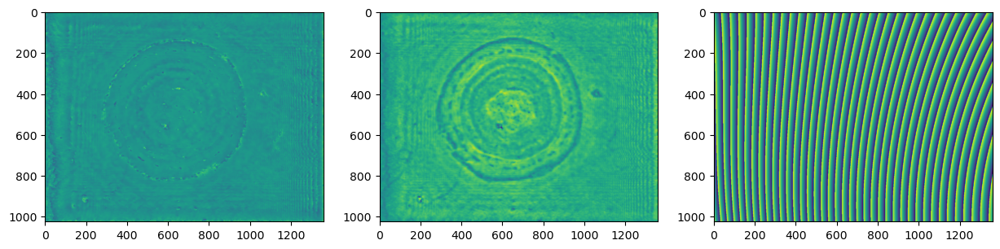

1201 0.06676565168998255
1202 0.06677852927453648
1203 0.06678182586198939
1204 0.06670152254804994
1205 0.06676173471279356
1206 0.06672168566028727
1207 0.06667831434717283
1208 0.06668368622932302
1209 0.06662561593845374
1210 0.06667420647983233
1211 0.06659771023795405
1212 0.06663056156072415
1213 0.0665804812442427
1214 0.06655689997516341
1215 0.06658841078122853
1216 0.06656486000464296
1217 0.06661919213072279
1218 0.0665648998888228
1219 0.0666357115722357
1220 0.06658050989801292
1221 0.06657886259200804
1222 0.06655452664554784
1223 0.06655121429087629
1224 0.06652184761204842
1225 0.06656341056002552
1226 0.06653613702877519
1227 0.06660189057786131
1228 0.06650627835806408
1229 0.06651692469111814
1230 0.06643912055141185
1231 0.06646898174382035
1232 0.06646322342816037
1233 0.0664992167588988
1234 0.06643941927168955
1235 0.06650719635337324
1236 0.06647393842301212
1237 0.06647291526729775
1238 0.0664625562836547
1239 0.06651362619019133
1240 0.06643633928055587
1241 

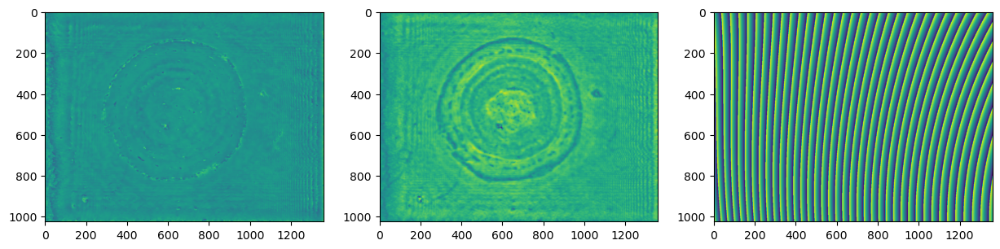

1401 0.06520797958666638
1402 0.06521173176378968
1403 0.06516236183796996
1404 0.0651925369874275
1405 0.06517908206714537
1406 0.06512907278297211
1407 0.06518218381719604
1408 0.0651025162360491
1409 0.0651132625093831
1410 0.06507858890504382
1411 0.0651279820480738
1412 0.06507081451054854
1413 0.06513420214245993
1414 0.06506879160138064
1415 0.06511790742517376
1416 0.06508169402600694
1417 0.06509623544398961
1418 0.06505442165545769
1419 0.06506346066169078
1420 0.0650552251799012
1421 0.06506818997892422
1422 0.06503701633799167
1423 0.06509330137901559
1424 0.06500599715153958
1425 0.06506833223772235
1426 0.06495575499086016
1427 0.0650229981836506
1428 0.06496839859200067
1429 0.06496318534491333
1430 0.0649686374521753
1431 0.06495216991550307
1432 0.06495708258795282
1433 0.06499078520083929
1434 0.06490951581541782
1435 0.0649756504834593
1436 0.06494846762362176
1437 0.06498284854667774
1438 0.06497740147381542
1439 0.0649746779030429
1440 0.06495214840333213
1441 0.06

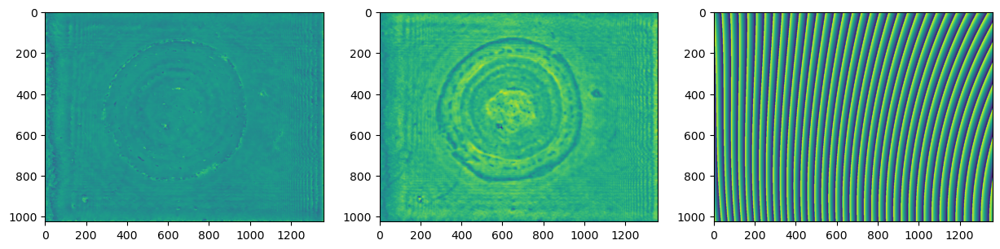

1601 0.06402192118884979
1602 0.06395455238598743
1603 0.06404958427550145
1604 0.06398540443061146
1605 0.06402543530570656
1606 0.06400295516236253
1607 0.06400866701869395
1608 0.06394776862491186
1609 0.06404237033968199
1610 0.06388632376529538
1611 0.06398846609348759
1612 0.06395237615198841
1613 0.06395787771843886
1614 0.06398090907071585
1615 0.06398439533661636
1616 0.06399973957278936
1617 0.06396316811559413
1618 0.06393903492615599
1619 0.06394409978551971
1620 0.06384575793744396
1621 0.06392205119211172
1622 0.06389748105185386
1623 0.06387317817467773
1624 0.06398515879178468
1625 0.06394716637792729
1626 0.06395187906652525
1627 0.06394942721389874
1628 0.06400759540688482
1629 0.06397932685494022
1630 0.06397620667361838
1631 0.06395200698789234
1632 0.0639863883183003
1633 0.06394364445561974
1634 0.06393658554595116
1635 0.06393790281848552
1636 0.06394319499752474
1637 0.06393581366921736
1638 0.06396593591055177
1639 0.06392419769661542
1640 0.0639196620066928
16

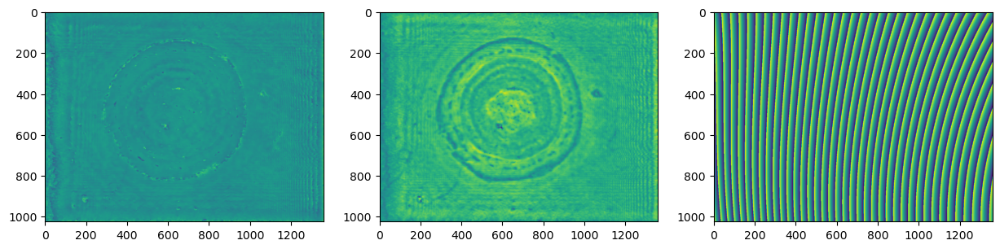

1801 0.06294478672303817
1802 0.0629322596156128
1803 0.06295103076434563
1804 0.06294736903127358
1805 0.06293517944057651
1806 0.06298481586001062
1807 0.0629946618474139
1808 0.06302421375339803
1809 0.06299941408880891
1810 0.06299848490428304
1811 0.06296209100743551
1812 0.06300950009814527
1813 0.0629461636268795
1814 0.06298609557769662
1815 0.06297487853534856
1816 0.06290132032653556
1817 0.0629455471878815
1818 0.06293098805934441
1819 0.06290160275438939
1820 0.0629443982056848
1821 0.06289370559549365
1822 0.06291737768388526
1823 0.06290025251154588
1824 0.06287899159000979
1825 0.06283482957796618
1826 0.0628532362462112
1827 0.06278070993682142
1828 0.06286964923747701
1829 0.0627877457749997
1830 0.06286157051794236
1831 0.0628030152524144
1832 0.06286244284831588
1833 0.06285271471956945
1834 0.06281190087568626
1835 0.06278941272194942
1836 0.0627953979181357
1837 0.0627493315258673
1838 0.06281472160310288
1839 0.06271150342414238
1840 0.06278860191934826
1841 0.062

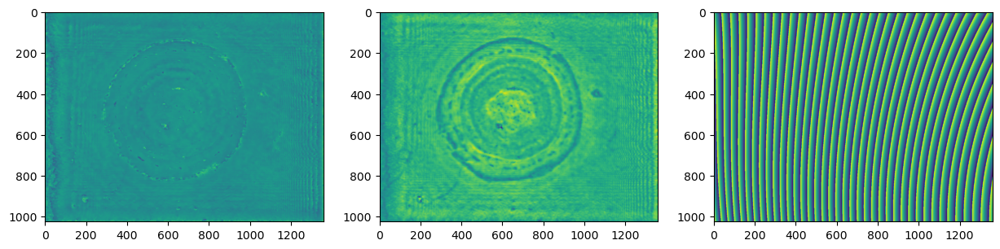

2001 0.06207064674193792
2002 0.062164848114437815
2003 0.062111760837063296
2004 0.06211364761464078
2005 0.06207019615418584
2006 0.06209049018219844
2007 0.06201181220864141
2008 0.06209906293742615
2009 0.06202847780511593
2010 0.06204567172376961
2011 0.06201608630632216
2012 0.062024579521847076
2013 0.06200180377107188
2014 0.06210838771265559
2015 0.06203370431471876
2016 0.06214183393705938
2017 0.062051855523071506
2018 0.06212528215024268
2019 0.06205148617558697
2020 0.06209687290988535
2021 0.062095505204721665
2022 0.062055578695473804
2023 0.06202435393780896
2024 0.06210308126589194
2025 0.0620304185600202
2026 0.06210348709012111
2027 0.06206394545688889
2028 0.062067967915400646
2029 0.06205143082652464
2030 0.06204478500194929
2031 0.0620726715973962
2032 0.06203295510466499
2033 0.06207653442938932
2034 0.06200602168016317
2035 0.062018261222457675
2036 0.06200943638595627
2037 0.06197521174046439
2038 0.062043420987240805
2039 0.06192046059576116
2040 0.06203798900

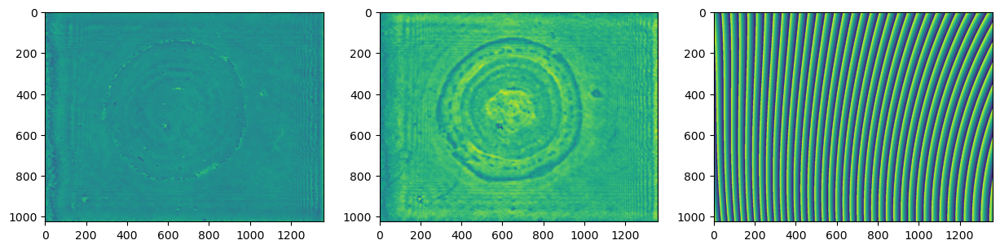

2201 0.061447743204019245
2202 0.0614390313066692
2203 0.06142450403039172
2204 0.06142208006554868
2205 0.06144820056040323
2206 0.061434129411088015
2207 0.06139600211494961
2208 0.061457562879110805
2209 0.06139255628688103
2210 0.06141552276769797
2211 0.061420407841902475
2212 0.06139882445557618
2213 0.06142628997321463
2214 0.06145704149005811
2215 0.061372345624523886
2216 0.061407741484159895
2217 0.06136878622161904
2218 0.061365579430145756
2219 0.06136421741325265
2220 0.06135288976136214
2221 0.06136786783411263
2222 0.06137358126757057
2223 0.06138023449555974
2224 0.06137958806805302
2225 0.06141549494557161
2226 0.06142277411683488
2227 0.06139425036394435
2228 0.06140904344081815
2229 0.06136009587818659
2230 0.06138578897708841
2231 0.06144000807308843
2232 0.06141801092874319
2233 0.06147664529609263
2234 0.061409515574742224
2235 0.06141672996323663
2236 0.06140064672447404
2237 0.061393759576751
2238 0.06138840535159411
2239 0.0613812570004441
2240 0.06132493219137

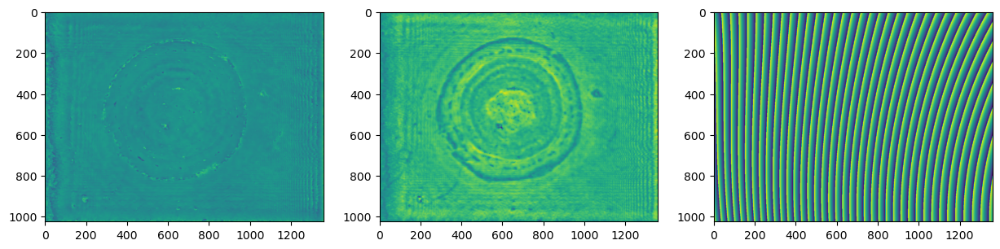

2401 0.060904244411977115
2402 0.060894259018638895
2403 0.06088431646722108
2404 0.060912530260787676
2405 0.06097494853537311
2406 0.060846671468840825
2407 0.060907357750469675
2408 0.06079050832074116
2409 0.06084010850784004
2410 0.06082849645580158
2411 0.06082936152203042
2412 0.0608069141728485
2413 0.060825296457349666
2414 0.060833731781433996
2415 0.06083593499330078
2416 0.06077665257282144
2417 0.06084112670098335
2418 0.06081251682389713
2419 0.06081434428742716
2420 0.060825529100129394
2421 0.06077361172765752
2422 0.060828719698588433
2423 0.06080351253565609
2424 0.060845303033485044
2425 0.060895460136848156
2426 0.06079547556992122
2427 0.060824938136911935
2428 0.060779041994506455
2429 0.06086092293838717
2430 0.06077050223067209
2431 0.060808786607146864
2432 0.06081239344743101
2433 0.06080915908847108
2434 0.06081776099488673
2435 0.060865770797254304
2436 0.06082822036524301
2437 0.06088350656052985
2438 0.06083423250543964
2439 0.06084501798198261
2440 0.0607

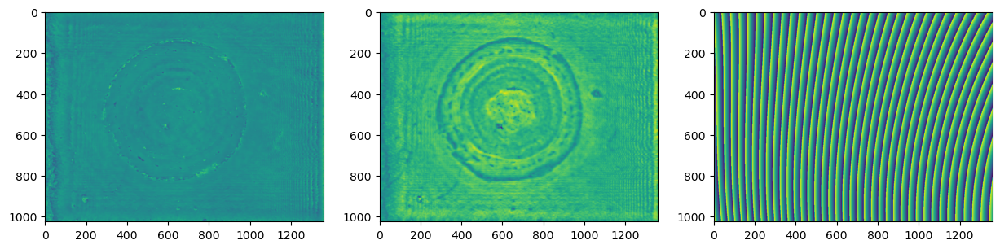

2601 0.06037375339951873
2602 0.060349429269965935
2603 0.06030481470484132
2604 0.06032324776422751
2605 0.060341602380391574
2606 0.06028572000156157
2607 0.06031042147723535
2608 0.06030963698529103
2609 0.06030291819269519
2610 0.06031387741074182
2611 0.06024838127219047
2612 0.06033428564562546
2613 0.06027143666197268
2614 0.06030111873553458
2615 0.0602584044698338
2616 0.060290577888394356
2617 0.06025078959171218
2618 0.060303684384226036
2619 0.06024345052794573
2620 0.060237225568236144
2621 0.060254182972844544
2622 0.060234626232492136
2623 0.060251092636434606
2624 0.060220338307599076
2625 0.060259645438124995
2626 0.06021249214212465
2627 0.06022254682311971
2628 0.0602107389732793
2629 0.06019863534103341
2630 0.06022689183582727
2631 0.060194213843193456
2632 0.06022126954535371
2633 0.06024011390927214
2634 0.060199404776783046
2635 0.06022362829222862
2636 0.060175297199499635
2637 0.06022139073948579
2638 0.060169779453580485
2639 0.06020095921154288
2640 0.060192

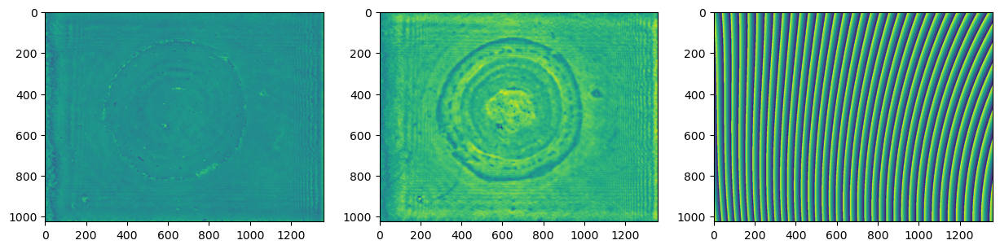

2801 0.0598644646385868
2802 0.05985089901061415
2803 0.059850774938860485
2804 0.05990327396942707
2805 0.05986687696601291
2806 0.059852707328501245
2807 0.05989176863447338
2808 0.05983456271296324
2809 0.05984402440280488
2810 0.05987031178337621
2811 0.05986160498328898
2812 0.05983130778860671
2813 0.05986748610822576
2814 0.059864116295006244
2815 0.05985359304630436
2816 0.05982530368971189
2817 0.059797214601132534
2818 0.059838011689068396
2819 0.05977208904419081
2820 0.05980681150478104
2821 0.05985028088537661
2822 0.05979671313954143
2823 0.05982292375934565
2824 0.05985276993892197
2825 0.05979986791518718
2826 0.05982193655043831
2827 0.05979489782734129
2828 0.05983413940564542
2829 0.05985678815899852
2830 0.05983897892295871
2831 0.05980142557001565
2832 0.0598136698225156
2833 0.059805061025231664
2834 0.059856552297486015
2835 0.05978112514706549
2836 0.05981407403022733
2837 0.05973808769275751
2838 0.05981588745735561
2839 0.059770844055653645
2840 0.059799827040

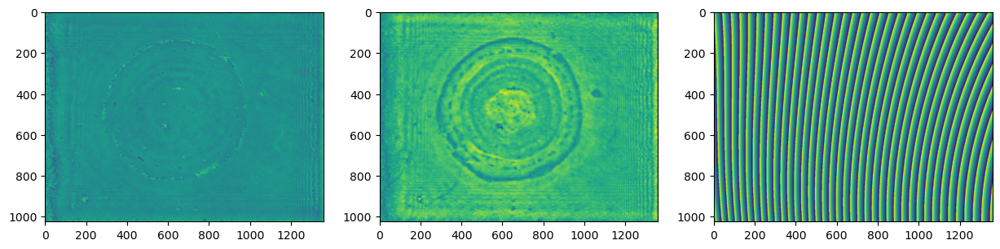

3001 0.05942327251617437
3002 0.05944469007259254
3003 0.05941403926551827
3004 0.05944733509116294
3005 0.05939609671913535
3006 0.05946400770193709
3007 0.05940723520708716
3008 0.05944200448478533
3009 0.059419933210755296
3010 0.05939384714316343
3011 0.05938380313417557
3012 0.05938495611222881
3013 0.059373962579992175
3014 0.059415437772249544
3015 0.05941272589618855
3016 0.059419166362985686
3017 0.05934410190239424
3018 0.059396196765987154
3019 0.059316800668779174
3020 0.05933718463208505
3021 0.05934469234397277
3022 0.059450899188759745
3023 0.059384954194764764
3024 0.05949946948259037
3025 0.05938694416327081
3026 0.05944504997943196
3027 0.059458557688130145
3028 0.05936574175467926
3029 0.0594380363945497
3030 0.05936230803128492
3031 0.059361553249019094
3032 0.05937982948746963
3033 0.059358601237801
3034 0.05937933335028206
3035 0.059365820381452473
3036 0.05939667098164072
3037 0.059312972560989344
3038 0.059390648984476435
3039 0.05929201954774352
3040 0.05937639

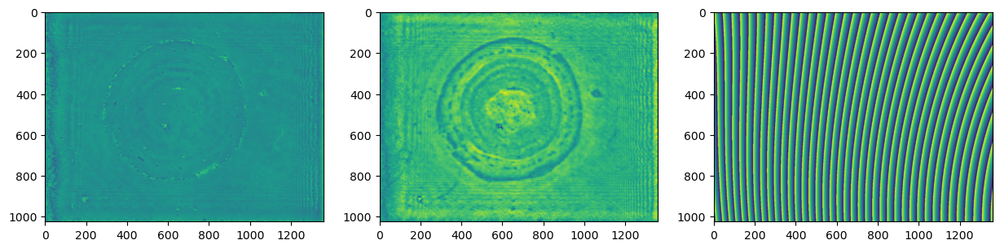

3201 0.05920222552588118
3202 0.059148955813116744
3203 0.05918087020940363
3204 0.059179758576843725
3205 0.05916345995976121
3206 0.059156680370959905
3207 0.059142618387041365
3208 0.05913756786305874
3209 0.059131962092415585
3210 0.059140378835802226
3211 0.059124701556328915
3212 0.059143877013588406
3213 0.05914563483122384
3214 0.05913882543535746
3215 0.05920434430154547
3216 0.059089056591148874
3217 0.05918556905017541
3218 0.059081960527077704
3219 0.05913217314511005
3220 0.05909999689260005
3221 0.05909809322519218
3222 0.059077812775721855
3223 0.059119731900069264
3224 0.05906488007572015
3225 0.059070260685469965
3226 0.05906046559006898
3227 0.05909771827488981
3228 0.05903736906270829
3229 0.05912286973821395
3230 0.05901382970319993
3231 0.05906215672263952
3232 0.05901935402698576
3233 0.05906064381388122
3234 0.05909470793050738
3235 0.05902719815958937
3236 0.059032592479201035
3237 0.058975181874913706
3238 0.05895041471140422
3239 0.05897675090490383
3240 0.058

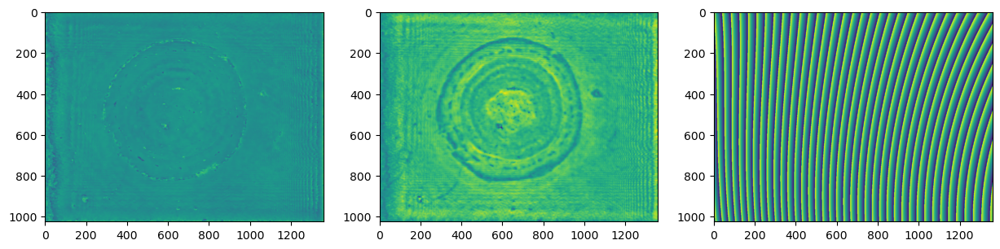

3401 0.05876217003381873
3402 0.05878079946365403
3403 0.0587301893541184
3404 0.058809164383743215
3405 0.058770297905100945
3406 0.058777400366207246
3407 0.05882155019029396
3408 0.058703899656952524
3409 0.058831932436891436
3410 0.05872246736034081
3411 0.058789490094427216
3412 0.05874774258215044
3413 0.058754920749649955
3414 0.0587461959132988
3415 0.058776513820071735
3416 0.0587767570712817
3417 0.058784137115556856
3418 0.05876280552033176
3419 0.05880822703895469
3420 0.05872773154493844
3421 0.05879878341262353
3422 0.058760125703605684
3423 0.058737334107712674
3424 0.05878314778636942
3425 0.05871832464401633
3426 0.058757288995941584
3427 0.058747946390708586
3428 0.05875571759346227
3429 0.058726025920537675
3430 0.05877535780826701
3431 0.0587168166869007
3432 0.05875788970250699
3433 0.05879708329984945
3434 0.05879903233673549
3435 0.05875348347865299
3436 0.05872703068317421
3437 0.058795210185668426
3438 0.05875612616464862
3439 0.058743739608349804
3440 0.058779

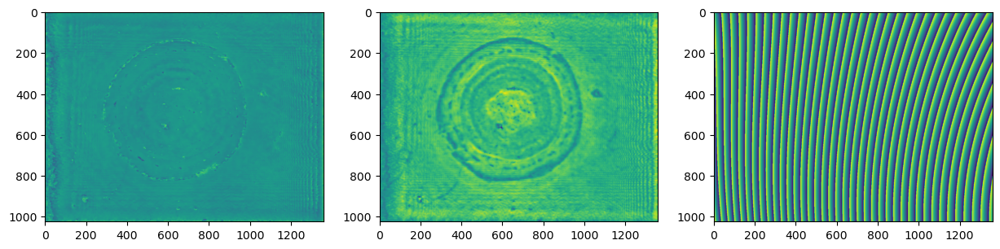

3601 0.05810751119960958
3602 0.05809195419678459
3603 0.05814724144591446
3604 0.058121739839561426
3605 0.05817245217135639
3606 0.05815654348451236
3607 0.05818508303480761
3608 0.0582017758108755
3609 0.05819687485979626
3610 0.05820169211767785
3611 0.05817684330492179
3612 0.058192358171894526
3613 0.05816925297670908
3614 0.05821790621606637
3615 0.058236518767883494
3616 0.0582382302214403
3617 0.05821354631276865
3618 0.0582792385529287
3619 0.058248063173290524
3620 0.058248454926459706
3621 0.0581888991989334
3622 0.05825035096984727
3623 0.05817402602586942
3624 0.058309044408806576
3625 0.05822274592729059
3626 0.05828013711544641
3627 0.05831925566448348
3628 0.058269416569142425
3629 0.05832510673066882
3630 0.05832201766794697
3631 0.05827349243191354
3632 0.05831384153489892
3633 0.058242468451718016
3634 0.05830551112625697
3635 0.05834041387570536
3636 0.058297016924270764
3637 0.058334314743105575
3638 0.05834178950973599
3639 0.05834172987612459
3640 0.058353451474

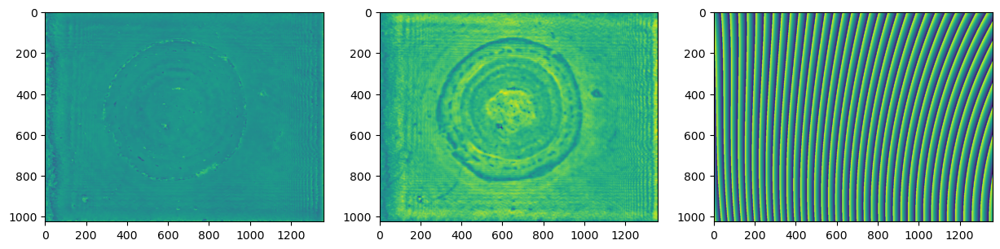

3801 0.058351496683458806
3802 0.058266578951191986
3803 0.05824393413023776
3804 0.05832904393561718
3805 0.05824043534873086
3806 0.05823116813399305
3807 0.058206545284450656
3808 0.05831637958581366
3809 0.058202565636082365
3810 0.0582931837884792
3811 0.05831604535198753
3812 0.05833119126771617
3813 0.05830600817494419
3814 0.058432936213183434
3815 0.05829755098528281
3816 0.05837977624008924
3817 0.05836187736397653
3818 0.0582138739376071
3819 0.058292340406621596
3820 0.05825459214048176
3821 0.05819558052582312
3822 0.05831848710271527
3823 0.05827186385418326
3824 0.058193536840455196
3825 0.05828380592093872
3826 0.05830128001399365
3827 0.05823968639378193
3828 0.05834995158773735
3829 0.05841504077453681
3830 0.05835172075655534
3831 0.05846048320302842
3832 0.058355251485033774
3833 0.0583546990927239
3834 0.05837619398971525
3835 0.058305315945747824
3836 0.05827672557869378
3837 0.05833753939991877
3838 0.058295267011882604
3839 0.058249171650506866
3840 0.0583256774

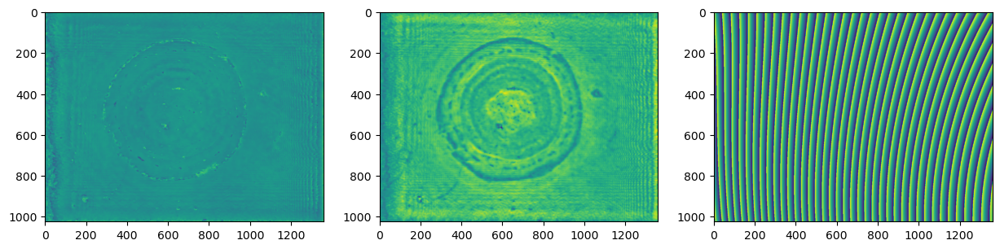

4001 0.05791845403529621
4002 0.058060464781417576
4003 0.05792923946838036
4004 0.05795479934450467
4005 0.057983226489444824
4006 0.057964766746187696
4007 0.05795065454947783
4008 0.057984119684108625
4009 0.057952297085116886
4010 0.057927908483287924
4011 0.05798782104980847
4012 0.05800771263552604
4013 0.05790909090026841
4014 0.05804879680694017
4015 0.05794783891109288
4016 0.057960796213356064
4017 0.05798818896122268
4018 0.05798899504347452
4019 0.057917825351688615
4020 0.05800547354235422
4021 0.05794246713133798
4022 0.057967844036230634
4023 0.05799764447318749
4024 0.05794231410566607
4025 0.05790464138795184
4026 0.05796674956782268
4027 0.05790927764162004
4028 0.05799648328367936
4029 0.057901621393769406
4030 0.057981700517446486
4031 0.05788231528969005
4032 0.05800155541927923
4033 0.057893575834051275
4034 0.05796512173666073
4035 0.058023686327681095
4036 0.0579768851497494
4037 0.057974887255967736
4038 0.058080183867310085
4039 0.05795035003758793
4040 0.0580

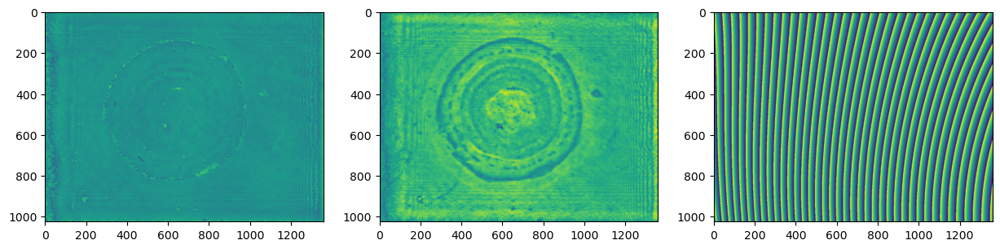

4201 0.05776639233084683
4202 0.057720896720462433
4203 0.05775702407139319
4204 0.05775777019815783
4205 0.057731679083777535
4206 0.057772932042285785
4207 0.05777453504351332
4208 0.05773428354954377
4209 0.05780024459038374
4210 0.05773325815409239
4211 0.057726770350112255
4212 0.05776700173214437
4213 0.057719967063086915
4214 0.05772529866325297
4215 0.057690696182211815
4216 0.057761373727609866
4217 0.05760658683582595
4218 0.057746176524485146
4219 0.05762381792976058
4220 0.05772530916936802
4221 0.057662669089195207
4222 0.0577046395281544
4223 0.05764308787317876
4224 0.05767939437633371
4225 0.05763831462831144
4226 0.0576725852583808
4227 0.057657440290856704
4228 0.0576469189531089
4229 0.057587501358929455
4230 0.05763526532888631
4231 0.057596153389262064
4232 0.05766520702423865
4233 0.05765883704555008
4234 0.05768232139835369
4235 0.05762442085165184
4236 0.05764917945700877
4237 0.0576409263045588
4238 0.057645517729330895
4239 0.05762586557832299
4240 0.057688909

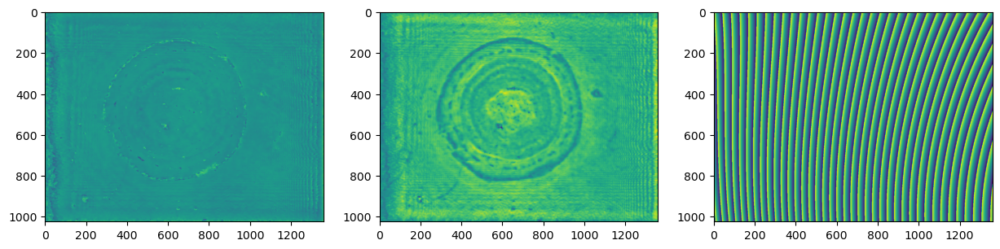

4401 0.057494336812489666
4402 0.05743828746216896
4403 0.05748728851427508
4404 0.05740731788361565
4405 0.057482068046566276
4406 0.05740539154983601
4407 0.057449762148121516
4408 0.05736827916180409
4409 0.05743950261491758
4410 0.0573860205567025
4411 0.05742337767388118
4412 0.05742657336046418
4413 0.05739926161999652
4414 0.0574496093546419
4415 0.0574101773641447
4416 0.05743432115552822
4417 0.057425183227515414
4418 0.05750760872567584
4419 0.057439222973104
4420 0.05742527473136756
4421 0.057447266569858754
4422 0.05740604595860499
4423 0.05739570912011653
4424 0.05747287062280351
4425 0.057447494862467446
4426 0.057461385326798745
4427 0.05747402263260346
4428 0.05744934191729853
4429 0.05748785787725082
4430 0.057455365337466535
4431 0.05749697650989777
4432 0.05746482117859843
4433 0.057502529563012286
4434 0.057486957618532945
4435 0.05749429945801623
4436 0.05747106278315687
4437 0.057496625974301274
4438 0.057387592819921764
4439 0.05750763487421456
4440 0.05739574610

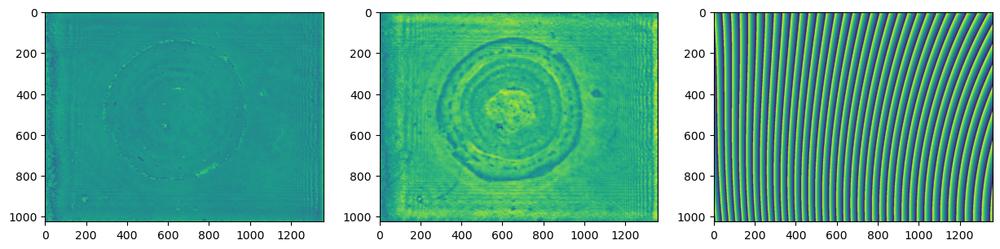

4601 0.05730792821050287
4602 0.05732414378550091
4603 0.057312475993142306
4604 0.0572552566031288
4605 0.05729649332164248
4606 0.057241881654933394
4607 0.05722111492656719
4608 0.05725803051883513
4609 0.05720682802253281
4610 0.05721729541989368
4611 0.05722818061713611
4612 0.057209142787032666
4613 0.057242438118906724
4614 0.05728372760216787
4615 0.05723739527331205
4616 0.05729206594031915
4617 0.05722450475832024
4618 0.05723173047753702
4619 0.05725535704104494
4620 0.05722748948090954
4621 0.05716943738210345
4622 0.05719622915382101
4623 0.05723645694168471
4624 0.05718020096140103
4625 0.05729203838964882
4626 0.05720508660094864
4627 0.05720967912992345
4628 0.05717947541254553
4629 0.05721282544887131
4630 0.0571950804488462
4631 0.057208585204410925
4632 0.05723118775988492
4633 0.05721721971173532
4634 0.0572297657804291
4635 0.05715398940550827
4636 0.05724045765979177
4637 0.057233420340665364
4638 0.05718517429564291
4639 0.05718660661716056
4640 0.057183827770882

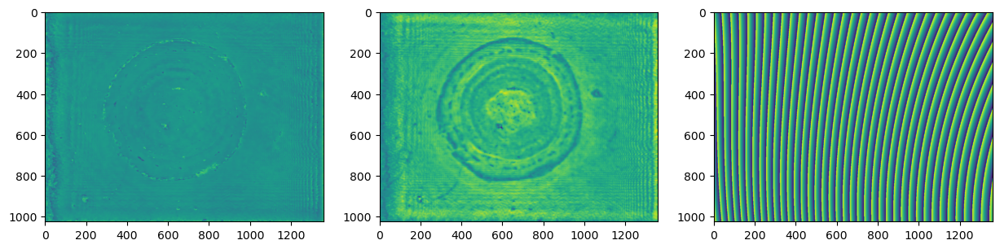

4801 0.05695971678586744
4802 0.05702610930998067
4803 0.056905499540608265
4804 0.056978750769904996
4805 0.056943361343685994
4806 0.05696110625685411
4807 0.05697853791733312
4808 0.05705927147627854
4809 0.05696648224562932
4810 0.05707690407539434
4811 0.056966148797407995
4812 0.05701849834701325
4813 0.05700531024354291
4814 0.05698415904924696
4815 0.05701924432553988
4816 0.057018900258566256
4817 0.0570119335325932
4818 0.05706844854636142
4819 0.0570517874592546
4820 0.057037568588615944
4821 0.05706366478787723
4822 0.057028244046775645
4823 0.05704393367072302
4824 0.057078690829897846
4825 0.05705571185308832
4826 0.05706505354848999
4827 0.05707115077329329
4828 0.05705658103697615
4829 0.05702965196661535
4830 0.05705933133736736
4831 0.057047210825484036
4832 0.05705766630569726
4833 0.05699861863495917
4834 0.057104338065095045
4835 0.05704283744350884
4836 0.05710705141011606
4837 0.05701524704962921
4838 0.057048718661800314
4839 0.05698488444968562
4840 0.057011826

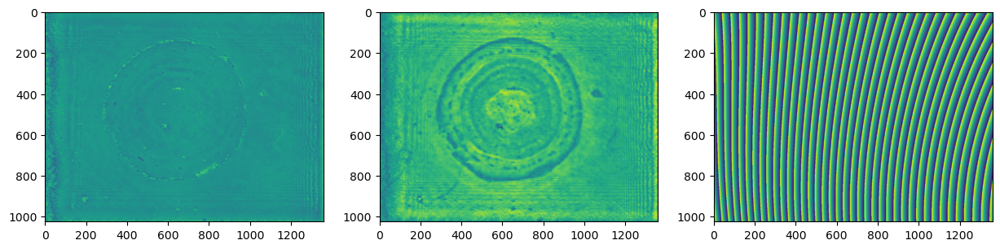

5001 0.056885144795972495
5002 0.0569839610445439
5003 0.056909855562957475
5004 0.05691166728594001
5005 0.05687226576495966
5006 0.05688339915101469
5007 0.05685480737883436
5008 0.056884477917028664
5009 0.056862055734814246
5010 0.0569078398217019
5011 0.05682195442340436
5012 0.05696082176747566
5013 0.056821713476923934
5014 0.056985136816268725
5015 0.056802030097242356
5016 0.05695966636618007
5017 0.05680626832557381
5018 0.056926830189448135
5019 0.056817761538605197
5020 0.05691100491605205
5021 0.05682480904555956
5022 0.056888564349741474
5023 0.05682004296715217
5024 0.05688032057473005
5025 0.05681552485502037
5026 0.05683139606009367
5027 0.05676465107915718
5028 0.056912289963381386
5029 0.05683638314895173
5030 0.056910578565548015
5031 0.056816076275329974
5032 0.05682577032828461
5033 0.05682432323347278
5034 0.056834870471834824
5035 0.05680679432416512
5036 0.05688389063456893
5037 0.05679533510286717
5038 0.05687053187786112
5039 0.0568479494867275
5040 0.0568602

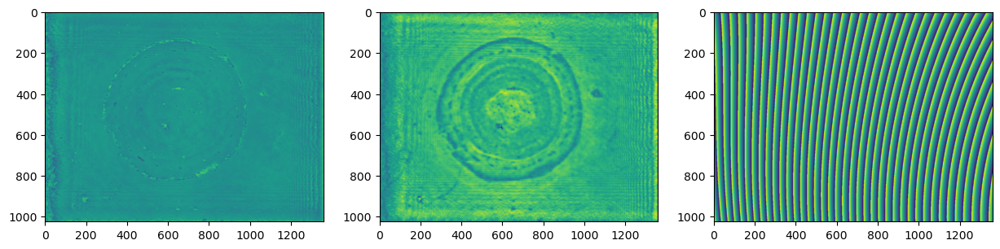

5201 0.056713280298212335
5202 0.056740004799870805
5203 0.05669504328414611
5204 0.05671644831737359
5205 0.05668205595048924
5206 0.056686888655009635
5207 0.056691647887024146
5208 0.05668587682925778
5209 0.05666066276252631
5210 0.0566839229284103
5211 0.05666692301688398
5212 0.056667265482611244
5213 0.056704337900574456
5214 0.0566967647608839
5215 0.05668979197551261
5216 0.056661290104892945
5217 0.0566591395618421
5218 0.05667274423259168
5219 0.05666349183758705
5220 0.056629276895419016
5221 0.05661654183910324
5222 0.056628487524999285
5223 0.05662574010273692
5224 0.05661395527101715
5225 0.05658960283793864
5226 0.056672945824402285
5227 0.05664059059205109
5228 0.05663973933861331
5229 0.056585357975830405
5230 0.05664061617522728
5231 0.056597890537452775
5232 0.05670080410560841
5233 0.056603455591473145
5234 0.056632985968014395
5235 0.05662379303295022
5236 0.05662049861003777
5237 0.05662606188661412
5238 0.05657801888509946
5239 0.05657572697240158
5240 0.0566129

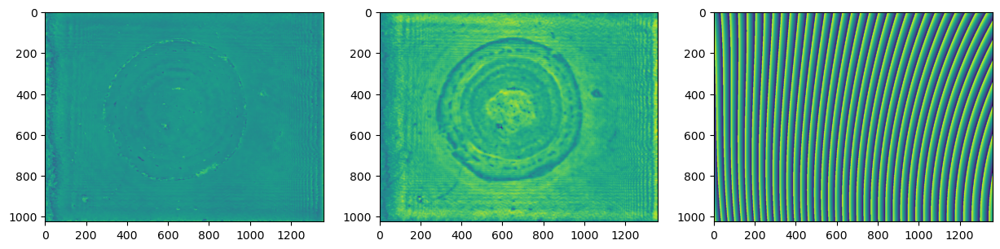

5401 0.05658117781919063
5402 0.05649932897125651
5403 0.05654136078750793
5404 0.05649103157621363
5405 0.05650755729760458
5406 0.05649848568616762
5407 0.056483895787740435
5408 0.05653762704026494
5409 0.0565416252957591
5410 0.056552767557375996
5411 0.05659606355525018
5412 0.05662927528502468
5413 0.056565986712633645
5414 0.05657338136536487
5415 0.05655505973303731
5416 0.0566051653557238
5417 0.056520906370279254
5418 0.056599394261500305
5419 0.0565763089162134
5420 0.05655059762862561
5421 0.05658520077995582
5422 0.05655338037453807
5423 0.05657771081124165
5424 0.05657726205207915
5425 0.05656565551222664
5426 0.05656689699049684
5427 0.05661869763061576
5428 0.05655225491756609
5429 0.056566887856217954
5430 0.05653953812674074
5431 0.05656796284514366
5432 0.05655196383452082
5433 0.056591273874211215
5434 0.056526895025967916
5435 0.05653513294946022
5436 0.056523346104985474
5437 0.056538965335632144
5438 0.0565430055897594
5439 0.05659436840499165
5440 0.056561859895

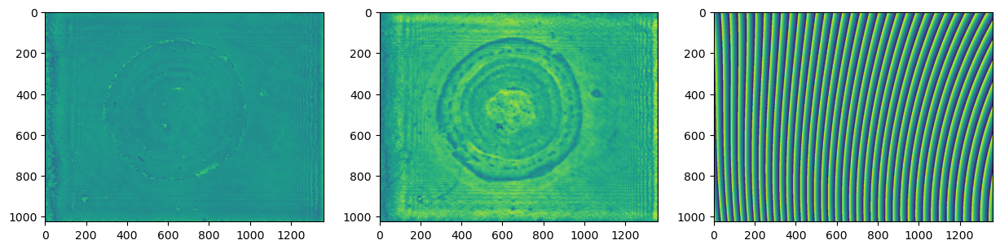

5601 0.05645709888254709
5602 0.056408061902294
5603 0.05640964678835407
5604 0.05646534805929804
5605 0.056315692855880436
5606 0.05639127093898689
5607 0.056374223000884294
5608 0.056430654075636105
5609 0.05634646385173159
5610 0.056431484853227604
5611 0.05643558686267593
5612 0.056350405873569834
5613 0.05645651753625973
5614 0.05642850212303276
5615 0.056337832045594755
5616 0.05647004045544281
5617 0.056356679161497045
5618 0.056350197475102844
5619 0.05635380503455138
5620 0.056331128020441074
5621 0.056293841274780265
5622 0.05639070084262654
5623 0.056306627887237226
5624 0.056320294612812516
5625 0.05633768503441719
5626 0.05640492063497416
5627 0.0563510502223845
5628 0.056431742902966535
5629 0.05640078877592541
5630 0.056333338281568404
5631 0.05642733652362103
5632 0.056349423413126945
5633 0.05639146166924292
5634 0.05640245058922916
5635 0.05637985138883949
5636 0.05638412345893742
5637 0.05637192167698929
5638 0.05637093027011211
5639 0.056289441183465655
5640 0.05633

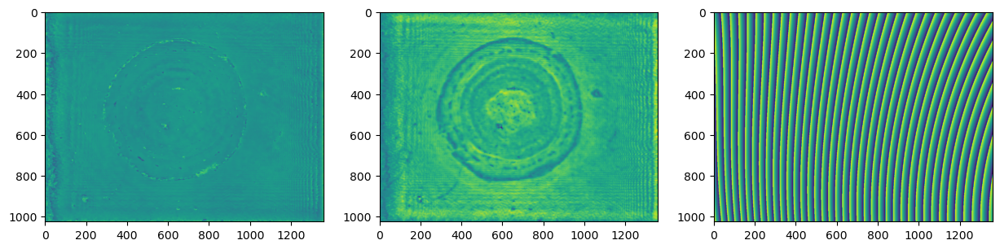

5801 0.05622693917075979
5802 0.056294616649537096
5803 0.056332541220211696
5804 0.05623049508224297
5805 0.056287963782706736
5806 0.056331149156988
5807 0.056303524277315886
5808 0.05628883892715694
5809 0.05635481884233552
5810 0.05632703310779577
5811 0.05633004272928714
5812 0.056334820594744664
5813 0.05633384856511821
5814 0.05627017698396492
5815 0.056337676108669445
5816 0.0563087575368626
5817 0.05620775786027518
5818 0.05636918330670611
5819 0.05616714271268196
5820 0.05628594560837758
5821 0.056216734662828796
5822 0.05614042601182963
5823 0.05619389762802428
5824 0.05619900195398107
5825 0.05617618191258244
5826 0.05625824570902525
5827 0.05619259921891416
5828 0.05624442737709526
5829 0.05621982918737944
5830 0.056215922649336364
5831 0.056224049387934474
5832 0.056251403620678264
5833 0.056222036452720704
5834 0.056289832707536645
5835 0.05615829805179931
5836 0.05634617679776009
5837 0.056193856951598654
5838 0.05627557254367778
5839 0.05627427506943814
5840 0.05620842

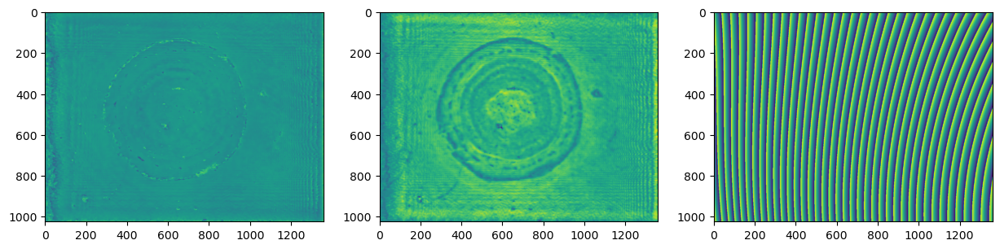

6001 0.05616896882535209
6002 0.056161981009112884
6003 0.05613635682819233
6004 0.05616801345892776
6005 0.05614959268842187
6006 0.05612503235004361
6007 0.056166797498361315
6008 0.05609589076162609
6009 0.0561181152278647
6010 0.0561376039130216
6011 0.05609850749949023
6012 0.05613071340292208
6013 0.056136299130287434
6014 0.056170909792471184
6015 0.056086902945442385
6016 0.05614446489850029
6017 0.056044000431928455
6018 0.056137971344384203
6019 0.05608309820325691
6020 0.05612011305763245
6021 0.05611148028966173
6022 0.056120100762510894
6023 0.056152301414392806
6024 0.05607623313480709
6025 0.05618818516494878
6026 0.05612645019541078
6027 0.05615527208363352
6028 0.05617600745711181
6029 0.05610149207117328
6030 0.056126270637072664
6031 0.05614615036426523
6032 0.056066759552432927
6033 0.05612893607566588
6034 0.05612719001772436
6035 0.05610746879114607
6036 0.056154097753228965
6037 0.05613528731622332
6038 0.05614858288708639
6039 0.05607259820257186
6040 0.05610199

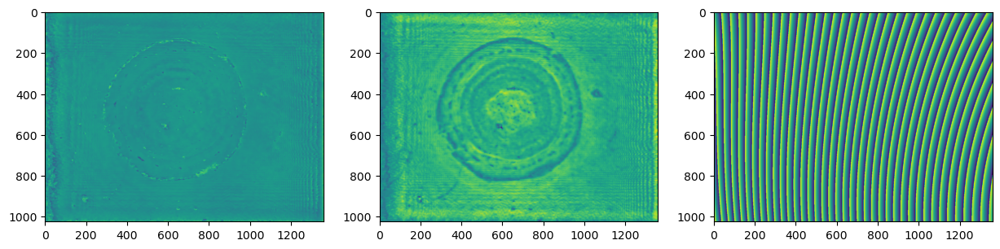

6201 0.055994708837459106
6202 0.05604431481187698
6203 0.056031305476400825
6204 0.055997646902374194
6205 0.05607553717864589
6206 0.05599236902250432
6207 0.05601956598897664
6208 0.05607470989012475
6209 0.05601774323826246
6210 0.05603314982134648
6211 0.056011057708191564
6212 0.05605589771699081
6213 0.055972075786067194
6214 0.05604718674747479
6215 0.05598781134451809
6216 0.05595958707453931
6217 0.05603442550479902
6218 0.05594527846199283
6219 0.05601717371256325
6220 0.0560311548202464
6221 0.05605554047628064
6222 0.056001350305261016
6223 0.056023094356573835
6224 0.056043683971418144
6225 0.055971995697079543
6226 0.05612317801478789
6227 0.055961229100170234
6228 0.055954126505425576
6229 0.05603287797231366
6230 0.056018948146381004
6231 0.05596160408574827
6232 0.05609971553271929
6233 0.055988734043167995
6234 0.0560987371023266
6235 0.05601976666839141
6236 0.05608824608445799
6237 0.05597569310491739
6238 0.056075186570311485
6239 0.05598398642524334
6240 0.055965

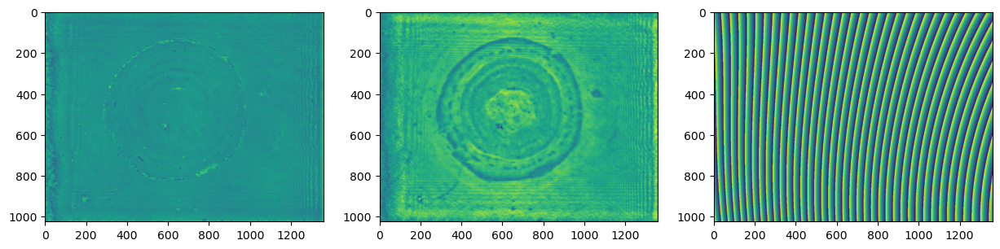

6401 0.05598133662731685
6402 0.05592380337258142
6403 0.05596466947109954
6404 0.0559494896690068
6405 0.05589372160608701
6406 0.05596318113094137
6407 0.05593956960347607
6408 0.055938210303274685
6409 0.05592979773311485
6410 0.05592724508973164
6411 0.05592361767932272
6412 0.05588078667836625
6413 0.05588472917543519
6414 0.05592558972946761
6415 0.0558867171746535
6416 0.055958528842211655
6417 0.05589062179891254
6418 0.05596462077354321
6419 0.055899657813383345
6420 0.055952057882623876
6421 0.05591469358844425
6422 0.05600630082120976
6423 0.05588880531019974
6424 0.05599294477005126
6425 0.05591081823078796
6426 0.055956304558195925
6427 0.055960349099724555
6428 0.05586477371966231
6429 0.05596449751895528
6430 0.05588150479674364
6431 0.0559120120063287
6432 0.05597999949845664
6433 0.05587097391599792
6434 0.05601553011730179
6435 0.05592791197324813
6436 0.05597992964772522
6437 0.055990533760452654
6438 0.05591866035830446
6439 0.0559666890097817
6440 0.055933759924328

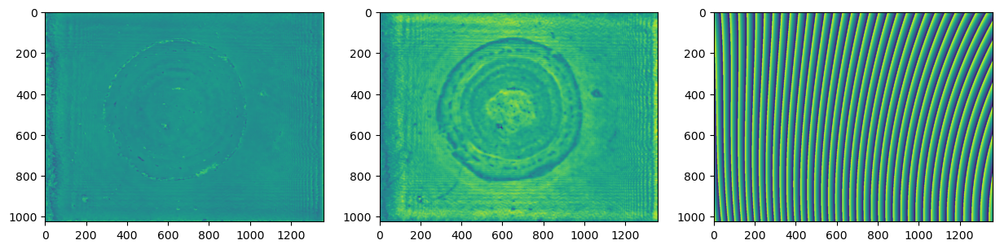

6601 0.05594781510110226
6602 0.055887618753359194
6603 0.05592183190297795
6604 0.05589084508182206
6605 0.055908323981375435
6606 0.055881659804815825
6607 0.055871142819237496
6608 0.05584269733816188
6609 0.05584607626307838
6610 0.05579795205217435
6611 0.05586270066097382
6612 0.05581253265277514
6613 0.055870178629901984
6614 0.05586775654832468
6615 0.05584118878140082
6616 0.05582559580297655
6617 0.05582137497688096
6618 0.05580305375294267
6619 0.05579118950687839
6620 0.05578077878158469
6621 0.05577101832206849
6622 0.055797993542523946
6623 0.05577924657243599
6624 0.05572590276071563
6625 0.05579250401691019
6626 0.055737256789724555
6627 0.05581089001889658
6628 0.055739867859091394
6629 0.05580862192753937
6630 0.05572557930074242
6631 0.05586917698197993
6632 0.05582155842693756
6633 0.05585642770012886
6634 0.05583254185833264
6635 0.05587365759719608
6636 0.055853618157041075
6637 0.05584523048048057
6638 0.055844540872533335
6639 0.05586170581475709
6640 0.05579684

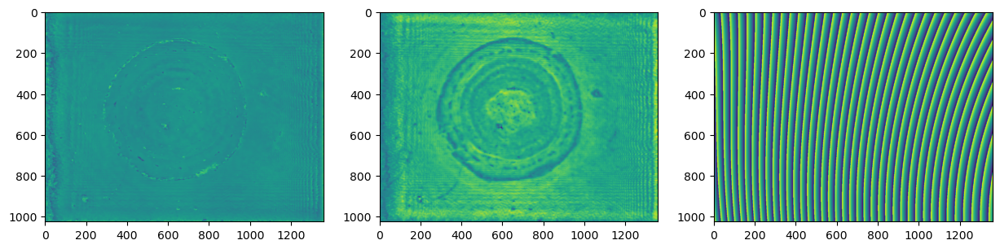

6801 0.055604148358089564
6802 0.055761587755307485
6803 0.05562888739307956
6804 0.055667463029732515
6805 0.055682957037217116
6806 0.05563176569838452
6807 0.05567007105720487
6808 0.05563795302191002
6809 0.055671634020453484
6810 0.05565476416722311
6811 0.055660994351843046
6812 0.05570922658409921
6813 0.055610019935743764
6814 0.05572004846439747
6815 0.055646991655826
6816 0.05569057107252326
6817 0.05565552692202669
6818 0.05575742100600455
6819 0.055657202031727554
6820 0.05571553729148872
6821 0.05572297219493147
6822 0.05567981960832009
6823 0.05569358453438272
6824 0.05564189589227772
6825 0.05570486918565912
6826 0.05565469180842586
6827 0.05566800035173289
6828 0.05573253307161448
6829 0.05560540782776113
6830 0.05570165747112307
6831 0.05563363342327607
6832 0.05570198953291221
6833 0.05561427638869432
6834 0.055699889188169364
6835 0.055635048121253486
6836 0.05566560779966666
6837 0.05562348239188677
6838 0.055671106120430636
6839 0.05564900823387893
6840 0.055685607

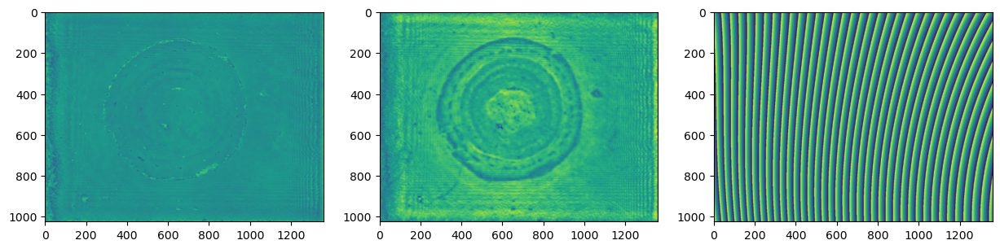

7001 0.055541804374007006
7002 0.055630732734938876
7003 0.0555452888588636
7004 0.05558151421326345
7005 0.055550175898777795
7006 0.055615558669594584
7007 0.055506974509761026
7008 0.05558958229720927
7009 0.055538800026714435
7010 0.05558597570844116
7011 0.055596611258806286
7012 0.055551700467450095
7013 0.05553209689168652
7014 0.05558780836932333
7015 0.05548318692688795
7016 0.05559137692702823
7017 0.055471482671207835
7018 0.055614385677157596
7019 0.055507165799859384
7020 0.05559045370058793
7021 0.055512125336279444
7022 0.055583777162770756
7023 0.05552143794404732
7024 0.05554766647197548
7025 0.05550775166379976
7026 0.055526785188312
7027 0.055483089741860045
7028 0.05550133386278595
7029 0.05549029866335674
7030 0.0555042086573887
7031 0.05551306186936138
7032 0.05552182604186907
7033 0.05551523142716587
7034 0.05554361293631509
7035 0.0555255176702812
7036 0.055527199649273
7037 0.055530814401332715
7038 0.05551297926794075
7039 0.05554250578905498
7040 0.0555561546

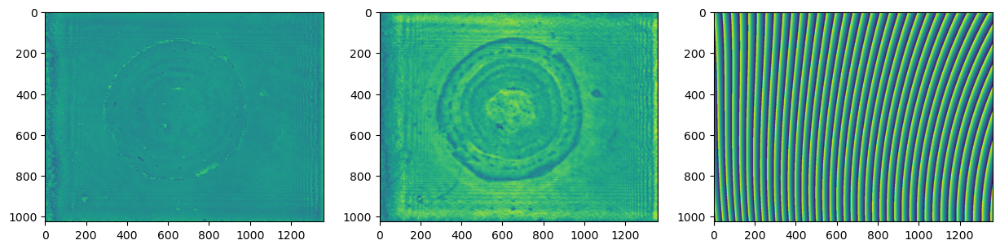

7201 0.05542641799820269
7202 0.05539590117944215
7203 0.05543643782990377
7204 0.0553905313029127
7205 0.055422588019285304
7206 0.055402192619549276
7207 0.055359578074596
7208 0.055456061084685336
7209 0.05540316167918814
7210 0.055457632168869786
7211 0.05545898595481926
7212 0.05542569336400553
7213 0.05547360629003737
7214 0.05539707154834119
7215 0.05540584249991269
7216 0.05543448849968242
7217 0.05540481854280599
7218 0.05542459318723664
7219 0.05539519243548982
7220 0.055413240683500675
7221 0.05544281663819181
7222 0.05544789456683213
7223 0.05543266479080684
7224 0.05538112369479979
7225 0.05545817212339288
7226 0.055372280471250784
7227 0.05542089541673481
7228 0.05544139835378326
7229 0.05543828967509389
7230 0.05549779532943737
7231 0.05550873010614811
7232 0.05546230514542885
7233 0.05545773874994071
7234 0.05542359704284062
7235 0.0553956019316563
7236 0.055386836234471465
7237 0.05538487086705069
7238 0.055434439511409445
7239 0.0553972950889577
7240 0.055385681607265

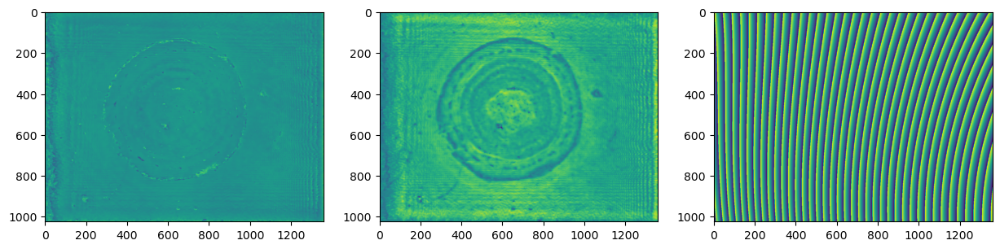

7401 0.05540844644523181
7402 0.05544160135092242
7403 0.05540130514120013
7404 0.055454811373541225
7405 0.05538190545267922
7406 0.05535529548417798
7407 0.05543388703482148
7408 0.05532832340642294
7409 0.05542549283955252
7410 0.05537391902268336
7411 0.055465702607074854
7412 0.05541804896385257
7413 0.05544310461914916
7414 0.0554252653047875
7415 0.05542651771432379
7416 0.05540975363092159
7417 0.05543737742579165
7418 0.05539212069922897
7419 0.055411133784294506
7420 0.05538804806103095
7421 0.055420272624875117
7422 0.055379536437233604
7423 0.0554746858340204
7424 0.055484992805309705
7425 0.05544504251715114
7426 0.055505989026411046
7427 0.05546581219299959
7428 0.055432118154884365
7429 0.05551207429096294
7430 0.055366530943671735
7431 0.05549969823899381
7432 0.05540226798622047
7433 0.05546724165622295
7434 0.05545302205425778
7435 0.05547238469317529
7436 0.05549784067499856
7437 0.055482300796087486
7438 0.05545039632427387
7439 0.055424492298477304
7440 0.055396131

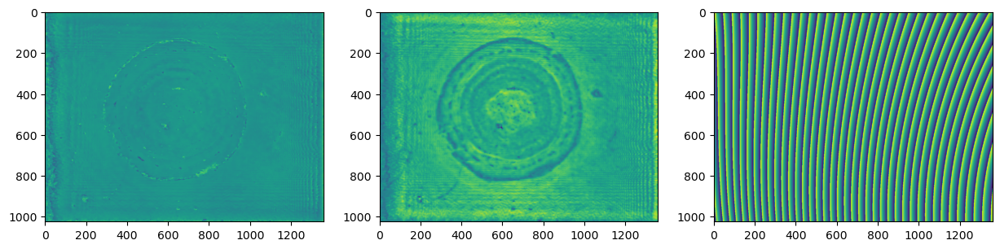

7601 0.05524260702371935
7602 0.055435741123376125
7603 0.055254449737294986
7604 0.05535452284233429
7605 0.05534615491584523
7606 0.05531935401026041
7607 0.055268613129081795
7608 0.05528867972537281
7609 0.055236662091260366
7610 0.05526679942013689
7611 0.055253311172900874
7612 0.05533937308651134
7613 0.05522211977563801
7614 0.05534148445268905
7615 0.05531446943017238
7616 0.05522066124386511
7617 0.05535966709316246
7618 0.05526101224284956
7619 0.05531005546496229
7620 0.055334700780648456
7621 0.055311911810116056
7622 0.05525210435760733
7623 0.05537715098288483
7624 0.05525751283574341
7625 0.05526074758759533
7626 0.05533631416091375
7627 0.055258395719100815
7628 0.05526104155281518
7629 0.05534073800701005
7630 0.055297538947419025
7631 0.05530302939426103
7632 0.055332388075576104
7633 0.05541727897339603
7634 0.055290753325264924
7635 0.055461905993900586
7636 0.05531270537355934
7637 0.05532422536414406
7638 0.055339840083077185
7639 0.0552809676473204
7640 0.055223

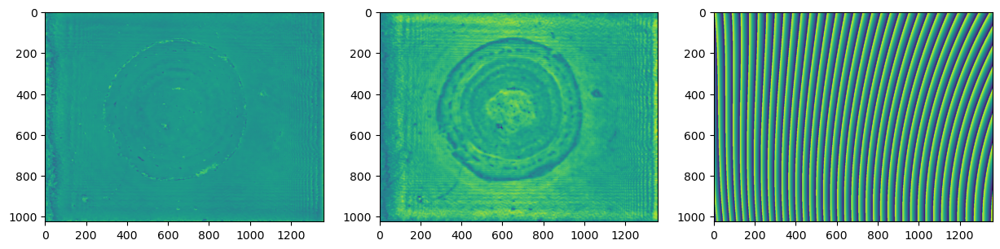

7801 0.05540536420040809
7802 0.05549419820846342
7803 0.05542941738943975
7804 0.05541431213465227
7805 0.055429895637240906
7806 0.05535454278777269
7807 0.055336799642338404
7808 0.05532293382505947
7809 0.05535595375297099
7810 0.055269421768416885
7811 0.055379478983858255
7812 0.05531880318980729
7813 0.0553310338994422
7814 0.055427069436041296
7815 0.05537788069166534
7816 0.05537976155776393
7817 0.05537492161120604
7818 0.05533194797001878
7819 0.05531170802032653
7820 0.05539738649283278
7821 0.05532256480065591
7822 0.055298886269759276
7823 0.055328843453837984
7824 0.0553263591737419
7825 0.055246590221877265
7826 0.0553658357987601
7827 0.05525846914684761
7828 0.055338600658997567
7829 0.05532161503586534
7830 0.05535734685578074
7831 0.05531011370296022
7832 0.055336474898152986
7833 0.05534718429105198
7834 0.05530734307429612
7835 0.05537387783973252
7836 0.05537112630184052
7837 0.05532852369017778
7838 0.05539671960250722
7839 0.05529821041227182
7840 0.05531387446

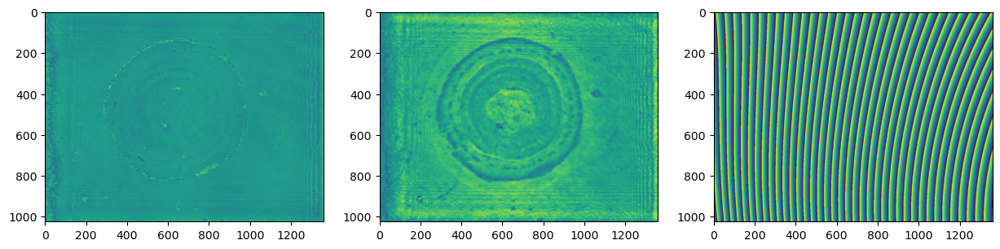

8001 0.055220918974965144
8002 0.05514513956608274
8003 0.05529285167496939
8004 0.05506798083639668
8005 0.055176529317924036
8006 0.05516635192920681
8007 0.05515994495612261
8008 0.0551617134547342
8009 0.05525007969225968
8010 0.0551966159240937
8011 0.055218989964907206
8012 0.05517514443786888
8013 0.05525073581745535
8014 0.055154341406006474
8015 0.05529343599609052
8016 0.05525551981633678
8017 0.05523179655355398
8018 0.05535258605677945
8019 0.05522214275408097
8020 0.05525303156225772
8021 0.05528318731878104
8022 0.05521765655532355
8023 0.05521909421639618
8024 0.05527178149517269
8025 0.05527685232253687
8026 0.05522416337365108
8027 0.05534051903446815
8028 0.05531102848407228
8029 0.05532557870176818
8030 0.05529068026402523
8031 0.05532628701577652
8032 0.05523927750467516
8033 0.05531816958068407
8034 0.055344178635601565
8035 0.05530409943529706
8036 0.055360711717492
8037 0.05525461988212302
8038 0.055250861776337166
8039 0.0552337005264119
8040 0.05518420254113555

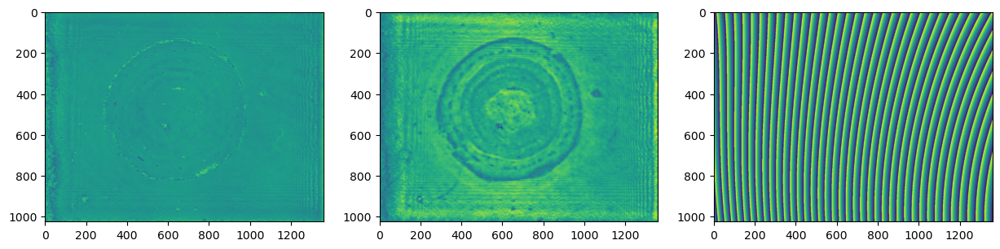

8201 0.05513370085427853
8202 0.055110522135261505
8203 0.05519257143499222
8204 0.05512103129293425
8205 0.055079562961252035
8206 0.055192528355110196
8207 0.0550986247155351
8208 0.055127483717291245
8209 0.0551024950283633
8210 0.055160200857640014
8211 0.05505026455339187
8212 0.05517204574384637
8213 0.05505250455964013
8214 0.055093185039383874
8215 0.05517349185469718
8216 0.0551300399721623
8217 0.055114496241804985
8218 0.05521233505308973
8219 0.05513755889384422
8220 0.055154051757344606
8221 0.055149782117211776
8222 0.055129094215454325
8223 0.05509011459724459
8224 0.05521340383983771
8225 0.055124552496653656
8226 0.05516381272979434
8227 0.055134460320135775
8228 0.055135857541587355
8229 0.05513413884232323
8230 0.05514211342678342
8231 0.05518053681196292
8232 0.05505321324047976
8233 0.05516742119526885
8234 0.05507291848760834
8235 0.05507440918511519
8236 0.05517545418944503
8237 0.05507833116182674
8238 0.05503943751449024
8239 0.05512154774257309
8240 0.05500493

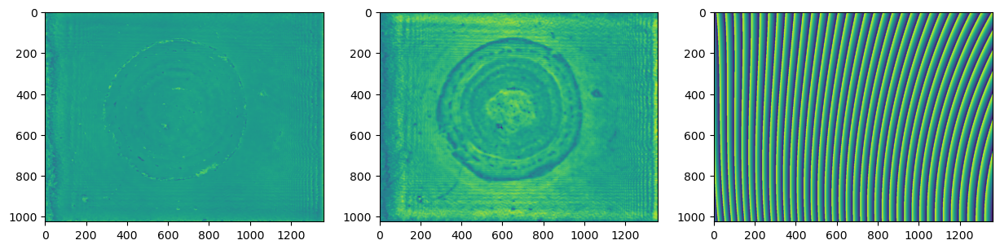

8401 0.055065606722214305
8402 0.05523948461447423
8403 0.055132924975395105
8404 0.05512215351664905
8405 0.0551693208555014
8406 0.05512711703270093
8407 0.055075927811828324
8408 0.05516453276773873
8409 0.05500039559539251
8410 0.05511934031355194
8411 0.05499573397369007
8412 0.055187495002656864
8413 0.055024924689968016
8414 0.05512275827161791
8415 0.0551021079984918
8416 0.055037513500487086
8417 0.055176864107137
8418 0.055059827857747205
8419 0.055120486952610195
8420 0.05511898469820767
8421 0.05514957317100992
8422 0.05511847459730662
8423 0.05515146939004577
8424 0.055064335124935596
8425 0.055095584088866785
8426 0.05503604081274033
8427 0.055140926247657526
8428 0.055002878232378136
8429 0.055124065913085885
8430 0.055057024428938575
8431 0.055103624944197
8432 0.055014850900616086
8433 0.055150015057728735
8434 0.055016323647743136
8435 0.05515403114421962
8436 0.05509017307657624
8437 0.05511927452870815
8438 0.05511814954477316
8439 0.055124370777124905
8440 0.055068

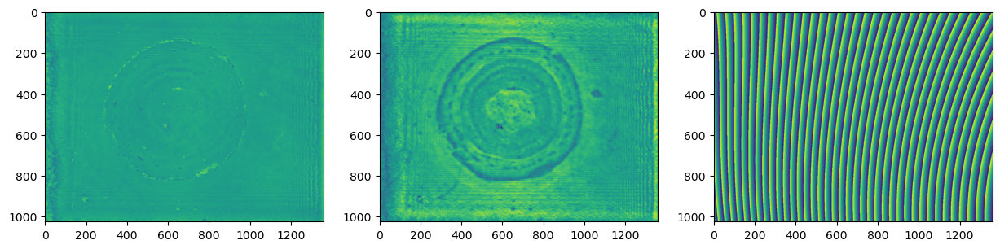

8601 0.054951648271798985
8602 0.054983033732530134
8603 0.05498692260818333
8604 0.05503013956565181
8605 0.055011226993898654
8606 0.05498143051393266
8607 0.05498908183537639
8608 0.05496576417531765
8609 0.05495536697394597
8610 0.05499607396227976
8611 0.05496047561530612
8612 0.05494692922789046
8613 0.05495065215213924
8614 0.05494196946620121
8615 0.054962056861521495
8616 0.0548849529895032
8617 0.05496494003414061
8618 0.05489495730491746
8619 0.05495515630748504
8620 0.05489550192742433
8621 0.05490212956280418
8622 0.05493447874810517
8623 0.05491708462393431
8624 0.05496494570829449
8625 0.054926657065983445
8626 0.054897982739459915
8627 0.05490795052606926
8628 0.054876990671093695
8629 0.0549272504818126
8630 0.054901424306636214
8631 0.054972425454773585
8632 0.054890554655621086
8633 0.05495362496765102
8634 0.054927450236660284
8635 0.05492337001941677
8636 0.05486977742044398
8637 0.0549651923541975
8638 0.05491832249077626
8639 0.05497279302654933
8640 0.0549475162

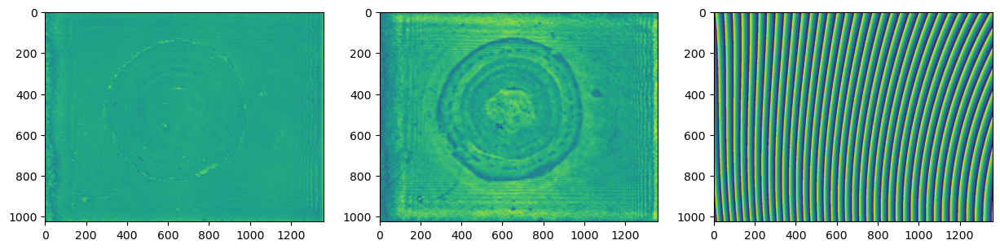

8801 0.05477740533520396
8802 0.05482532866722241
8803 0.05480766677500384
8804 0.05478175239703647
8805 0.054863519926249216
8806 0.05472656858428901
8807 0.054843587679016384
8808 0.05477240200952522
8809 0.05481587796336032
8810 0.05480333209188004
8811 0.05475673791419713
8812 0.05483262263097109
8813 0.05473277979637402
8814 0.05479670139935254
8815 0.054784322801762056
8816 0.05481850245836564
8817 0.05489121702415812
8818 0.05492287478510346
8819 0.054900014461895866
8820 0.054962259967905214
8821 0.054929504672815
8822 0.055032466200695504
8823 0.054917606325467966
8824 0.055002992312535734
8825 0.0549255239126309
8826 0.05501102373977923
8827 0.054994908284852456
8828 0.055004362282875044
8829 0.055002868944626526
8830 0.055061002532502554
8831 0.05489842576224732
8832 0.05504949295029343
8833 0.05495272188397009
8834 0.05497636578795453
8835 0.05495142291333978
8836 0.055004140626540625
8837 0.054967033861444456
8838 0.05496495803121261
8839 0.05489478518669429
8840 0.0549687

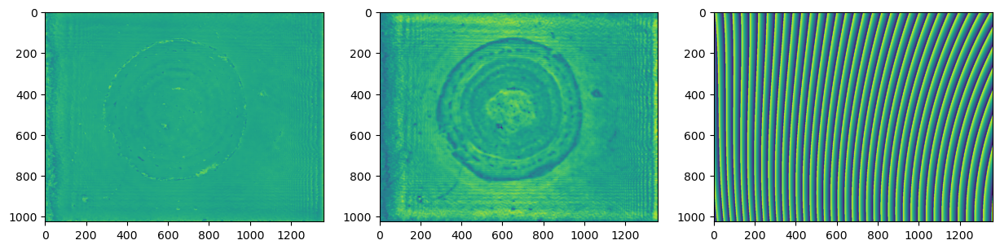

9001 0.05502881214587429
9002 0.0549642109319366
9003 0.05507070377567158
9004 0.05498917339509234
9005 0.054985290134267506
9006 0.05497355183280665
9007 0.0550053646734293
9008 0.05497845303122013
9009 0.05500761739516907
9010 0.05496214401203203
9011 0.05496295843754323
9012 0.0549646579949431
9013 0.05498080417403679
9014 0.0549962463759808
9015 0.05497318691278863
9016 0.055052770004487224
9017 0.05494239910825194
9018 0.05503984742069774
9019 0.05499051667520685
9020 0.054994108978148076
9021 0.05498965667791755
9022 0.054976988813654
9023 0.05503288340035979
9024 0.054977130337980934
9025 0.05506197494562229
9026 0.054970965507451924
9027 0.055055699007003425
9028 0.05500046458088831
9029 0.05502991588425858
9030 0.05501932030102073
9031 0.05500767994611622
9032 0.055018974048766406
9033 0.05504266324827081
9034 0.05494089277369618
9035 0.05500550281431131
9036 0.05496423516431852
9037 0.05497388812354545
9038 0.05497914269961403
9039 0.05498026195089462
9040 0.05497005607846240

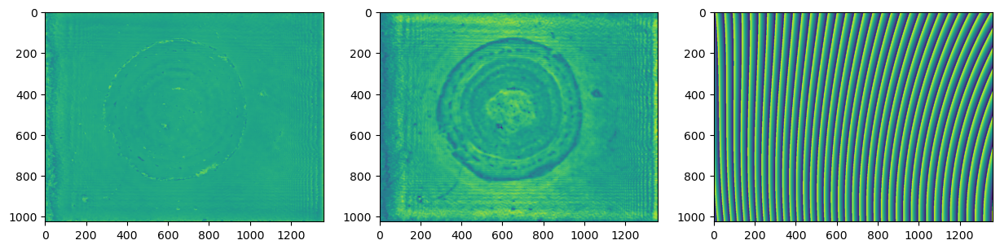

9201 0.05480560282421615
9202 0.05488559512394301
9203 0.05485644300021375
9204 0.05475020198967441
9205 0.054904246143866825
9206 0.0547637293889194
9207 0.05479453558563107
9208 0.0548532483431681
9209 0.05474403334659826
9210 0.05476403741511725
9211 0.05483646761893122
9212 0.05480394192685647
9213 0.05473097049400999
9214 0.054844803751796664
9215 0.05470126385963994
9216 0.05479271654134066
9217 0.054814108672464716
9218 0.054757864313304955
9219 0.05478418818445446
9220 0.054832821932478217
9221 0.054792015834698254
9222 0.05479808683051106
9223 0.05483903009300674
9224 0.054825998564374284
9225 0.05478029000201906
9226 0.05481248451057792
9227 0.05479258884940631
9228 0.054828587487894355
9229 0.05485927938252319
9230 0.0548913403128819
9231 0.05480589931581275
9232 0.05488443539830234
9233 0.054865464831605745
9234 0.05484906331991568
9235 0.054908692702588094
9236 0.05480852359229222
9237 0.054768935880990174
9238 0.05487804084085339
9239 0.054787204105180703
9240 0.054775248

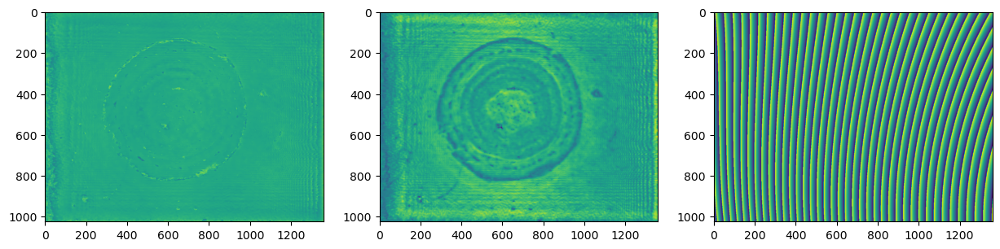

9401 0.054830727703500864
9402 0.05474541386919628
9403 0.05485246316847044
9404 0.054824864263752875
9405 0.05475928335736168
9406 0.0548884698442995
9407 0.054707859357676886
9408 0.05479469710594331
9409 0.05482192513515266
9410 0.05475982842569205
9411 0.054832405534577675
9412 0.05490394356822065
9413 0.05489479667727602
9414 0.054877909833247036
9415 0.0549123288213183
9416 0.05487942765602949
9417 0.0549047200447553
9418 0.054845573415565244
9419 0.05494378492878706
9420 0.05485109747650886
9421 0.05492509523607801
9422 0.054887675743245636
9423 0.054810368832593145
9424 0.054874776327447354
9425 0.05478012947617414
9426 0.05482158069483817
9427 0.05485331567638742
9428 0.05480957100647966
9429 0.05479961003774052
9430 0.05485979073100994
9431 0.05475120053634352
9432 0.05481286619326906
9433 0.05479901753088257
9434 0.054798679937759255
9435 0.05475996123302422
9436 0.05482317650004462
9437 0.05476979000216177
9438 0.054766898930652765
9439 0.05482139410618611
9440 0.0547539122

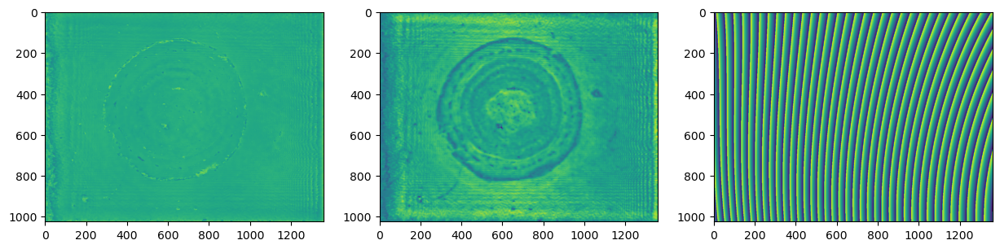

9601 0.05477986474993807
9602 0.05465392878249578
9603 0.054722541491271204
9604 0.054678949079638224
9605 0.05471137956929932
9606 0.05459266237173563
9607 0.05475615521641639
9608 0.054636534509667704
9609 0.05472033904210108
9610 0.0547030673451514
9611 0.05474103213457299
9612 0.05465946448959806
9613 0.05475676521313644
9614 0.054624326899867987
9615 0.0547043539364018
9616 0.05470089366988695
9617 0.05470009028074936
9618 0.05469703912763478
9619 0.054721317245917916
9620 0.05468993834556186
9621 0.05470242324076014
9622 0.054659461749606245
9623 0.05471258503837027
9624 0.05465866812978486
9625 0.054710243812620664
9626 0.054633723242865716
9627 0.054736935851027055
9628 0.05465042435591476
9629 0.054732813731943955
9630 0.05469169608222652
9631 0.05471781065339485
9632 0.05469424407827682
9633 0.054714580557696554
9634 0.05461696659424117
9635 0.05474072173778145
9636 0.05464732898347093
9637 0.05470585912527183
9638 0.05471699762748031
9639 0.05470441453046409
9640 0.054704862

KeyboardInterrupt: 

In [163]:
epochs = 10001
loss_arr = []


for itr in range(epochs):

    optimizer.zero_grad()
    # optimizer_proc.zero_grad()

    obj = obj_amp*torch.exp(1j*obj_phase)
    
    wave_phase = ((A)@coeffs).reshape(1024, 1360)
    wave = torch.exp(1j*wave_phase)
    
    wave_op = wave*obj

    wave_obj.wavefield(wave_op.T)
    dist = torch.tensor(155.003) # mm
    wave_at_img = wave_obj.propogate(dist)
    wave_z = torch.angle(wave_at_img)
    wave_z += cons
    loss_phase = loss_fn(wave_z, target_phase)/(1024*1360)
    loss_amp = loss_fn(torch.abs(wave_at_img), target_abs)/(1024*1360)

    loss = loss_amp + loss_phase

    # proc = model(obj_phase.unsqueeze(0).unsqueeze(0)).squeeze()
    # loss_proc = 0.9*l2_loss(proc, obj_phase) + total_variation_loss(proc, 0.1)

    loss.backward()
    # loss_proc.backward()
    
    optimizer.step()
    # optimizer_proc.step()

    loss_arr.append(loss.item())
    print(itr, loss_arr[-1])

    if (itr) % 200 == 0:

        fig, axs = plt.subplots(1, 3, figsize=(15, 8))

        axs[0].imshow(obj_phase.detach())
        # axs[1].imshow(proc.detach())
        axs[1].imshow(obj_amp.detach())
        axs[2].imshow(torch.angle(wave.detach()))

        plt.show()

In [164]:
dist, cons.grad

(tensor(155.0030), None)

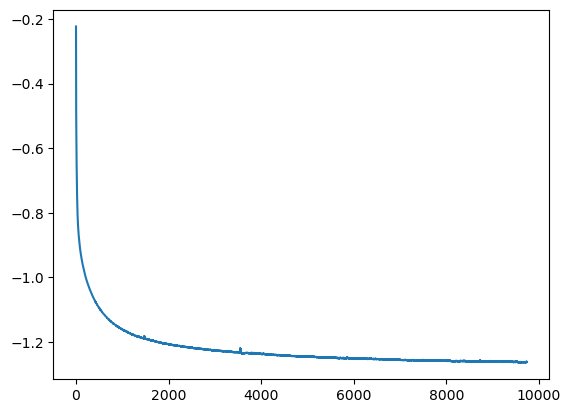

In [179]:
plt.plot(np.log10(loss_arr))

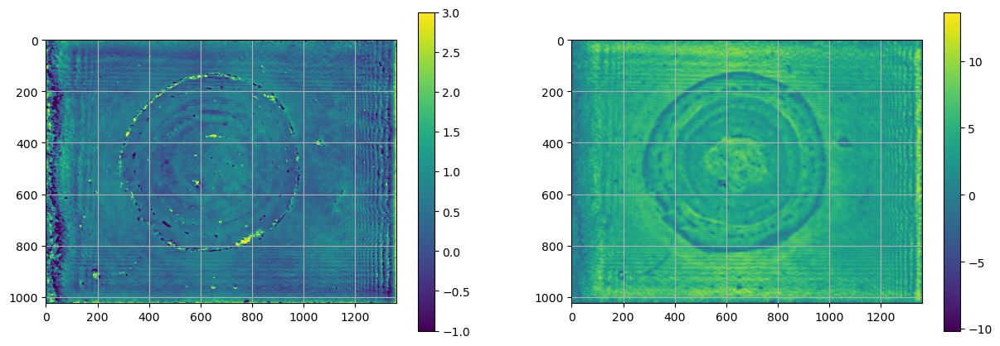

In [180]:
fig, axs = plt.subplots(1, 2, figsize=(15, 5))

cm1 = axs[1].imshow(obj_amp.detach())
cm0 = axs[0].imshow(obj_phase.detach(), vmin=-1, vmax=3)

fig.colorbar(cm0, ax=axs[0])
fig.colorbar(cm1, ax=axs[1])

axs[0].grid()
axs[1].grid()

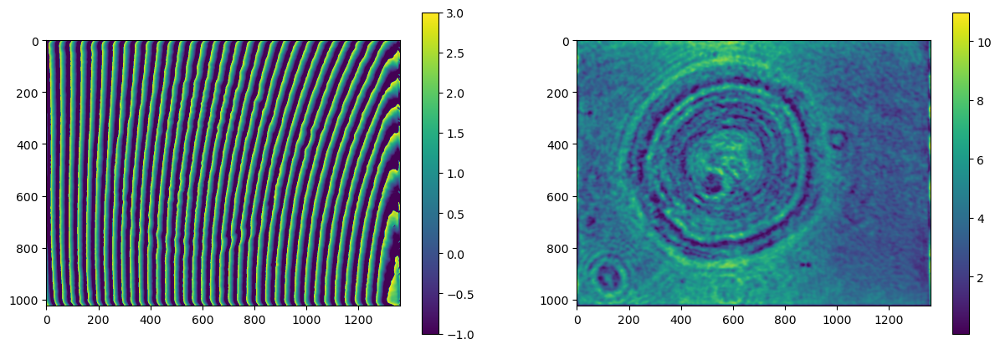

In [178]:
fig, axs = plt.subplots(1, 2, figsize=(15, 5))

cm1 = axs[1].imshow(torch.abs(wave_at_img).T.detach())
cm0 = axs[0].imshow(torch.angle(wave_at_img).T.detach(), vmin=-1, vmax=3)

fig.colorbar(cm0, ax=axs[0])
fig.colorbar(cm1, ax=axs[1])

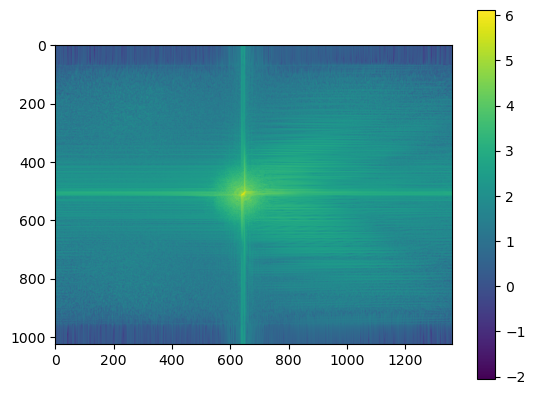

In [172]:
plt.imshow(np.log10(torch.abs(torch.fft.fftshift(torch.fft.fft2(wave_at_img.detach())))).T)
plt.colorbar()

tensor([[ -12.7241],
        [-114.5435],
        [ -12.9551],
        [   4.7421],
        [   6.8633],
        [-118.1326],
        [   2.3889],
        [   2.4276],
        [   1.5576],
        [   3.9442]], requires_grad=True)

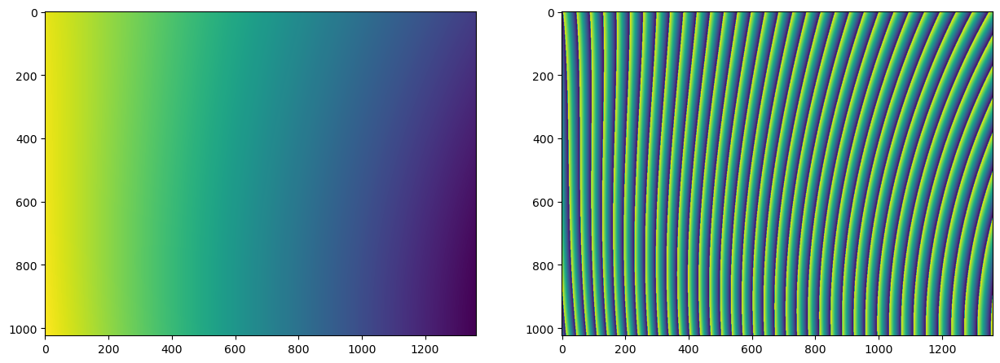

In [173]:
fig, axs = plt.subplots(1, 2, figsize=(15, 8))

axs[1].imshow(torch.angle(wave).detach())
axs[0].imshow(wave_phase.detach())

coeffs

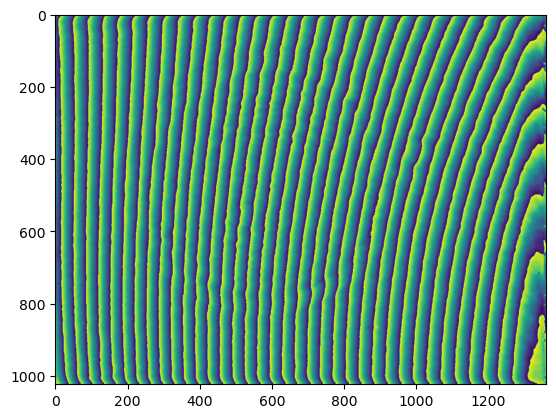

In [174]:
plt.imshow(wave_z.detach().T)

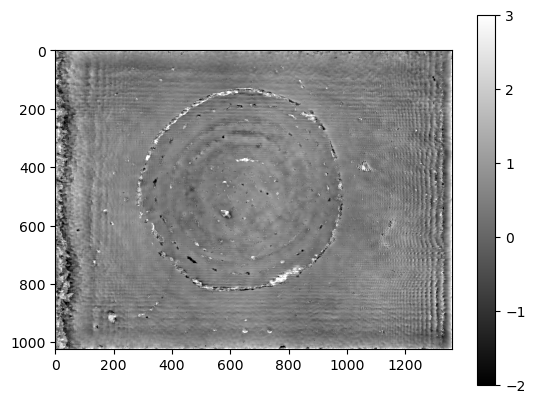

In [175]:
plt.imshow((obj_phase.detach().numpy()), cmap='gray', vmin=-2, vmax=3)
plt.colorbar()